<a href="https://colab.research.google.com/github/tsjannoun123-netizen/AI-for-Med.Diagnos.-Prediction-AAI_643O_O11_202610/blob/main/Week4_lesson3_Saera_Rawas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Notebook for practical exercises | Week #4 Lesson #3

## Introduction

This notebook contains practical hands-on exercises for the lesson about *Convolutional Neural Networks for Segmentation*.

After this session, you will know how to evaluate and improve the performance of a classifier for a real-world segmentation problem:
- Train CNNs for pixel‑wise (semantic) segmentation
- Benchmark several model architectures (UNet, FCN, DeepLabV3).
- Compare segmentation results using Dice and IoU scores.

## Dataset

We will use the [The Brain Resection Multimodal Imaging Database](https://www.cancerimagingarchive.net/collection/remind/) [1]. The Brain Resection Multimodal Imaging Database (ReMIND) contains pre- and intra-operative brain MRI collected on 114 consecutive patients who were surgically treated with image-guided tumor resection between 2018 and 2022.

[1] Juvekar, P., Dorent, R., Kögl, F., Torio, E., Barr, C., Rigolo, L., Galvin, C., Jowkar, N., Kazi, A., Haouchine, N., Cheema, H., Navab, N., Pieper, S., Wells, W. M., Bi, W. L., Golby, A., Frisken, S., & Kapur, T. (2023). The Brain Resection Multimodal Imaging Database (ReMIND) (Version 1) [dataset]. The Cancer Imaging Archive. [https://doi.org/10.7937/3RAG-D070](https://doi.org/10.7937/3RAG-D070)

Retrieve the repository

In [2]:
!git clone https://github.com/albarqounilab/AIM.git

fatal: destination path 'AIM' already exists and is not an empty directory.


In [3]:
!pip install SimpleITK -q

Import libraries

In [4]:
#@title Import libraries
import matplotlib.pyplot as plt
import seaborn as sns

import os
os.environ["CUDA_VISIBLE_DEVICES"] = "2"
import sys
import warnings
warnings.filterwarnings(action="ignore")
os.environ["PYTHONWARNINGS"] = "ignore"


import argparse
import math
from glob import glob

!pip install -U segmentation-models-pytorch -q
import albumentations as A
import numpy as np
import pandas as pd
import SimpleITK as sitk
sitk.ProcessObject.SetGlobalWarningDisplay(False)
import torch
import torch.nn as nn
import torch.optim as optim
from albumentations.pytorch import ToTensorV2
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
import cv2

# sitk.ProcessObject_SetGlobalWarningDisplay(False) # Redundant line

In [5]:
!pip install SimpleITK -q

### Download

If needed, run the following cells to download and unzip the dataset. If you already have the dataset downloaded, comment the two lines.

<div class="alert alert-block alert-danger">
<b>Replace the <code>DATA_PATH</code> with the path where you want to store the data folder. By default, it will be stored at the root of this repository.</b> <br>
<b>If you have already downloaded the dataset, comment the following cell by adding a <code>#</code> before the <code>!</code></b>
</div>

In [6]:
DATA_PATH = './'

!curl https://uni-bonn.sciebo.de/s/s1t8QUZ02MF1Qoh/download --output {DATA_PATH}/data.zip
!unzip {DATA_PATH}/data.zip -d {DATA_PATH}

Streaming output truncated to the last 5000 lines.
  inflating: ./data/ReMIND/sub-097/anat/T1w/1-055.dcm  
  inflating: ./__MACOSX/data/ReMIND/sub-097/anat/T1w/._1-055.dcm  
  inflating: ./data/ReMIND/sub-097/anat/T1w/1-032.dcm  
  inflating: ./__MACOSX/data/ReMIND/sub-097/anat/T1w/._1-032.dcm  
  inflating: ./data/ReMIND/sub-097/anat/T1w/1-026.dcm  
  inflating: ./__MACOSX/data/ReMIND/sub-097/anat/T1w/._1-026.dcm  
  inflating: ./data/ReMIND/sub-097/anat/T1w/1-146.dcm  
  inflating: ./__MACOSX/data/ReMIND/sub-097/anat/T1w/._1-146.dcm  
  inflating: ./data/ReMIND/sub-097/anat/T1w/1-152.dcm  
  inflating: ./__MACOSX/data/ReMIND/sub-097/anat/T1w/._1-152.dcm  
  inflating: ./data/ReMIND/sub-097/anat/T1w/1-185.dcm  
  inflating: ./__MACOSX/data/ReMIND/sub-097/anat/T1w/._1-185.dcm  
  inflating: ./data/ReMIND/sub-097/anat/T1w/1-191.dcm  
  inflating: ./__MACOSX/data/ReMIND/sub-097/anat/T1w/._1-191.dcm  
  inflating: ./data/ReMIND/sub-097/anat/T1w/1-190.dcm  
  inflating: ./__MACOSX/data/ReM

Download the previously trained model

In [7]:
# https://uni-bonn.sciebo.de/s/NHbxiRy8HpCpCCP/download/fcn_segmentation020_dice0.5179.pt --output {DATA_PATH}/fcn_segmentation020_dice0.5179.pt

### Dataset Class

Similarly to what we have done for classification and detection, we need to create a `Dataset` class for the segmentation task.
Observe the following cell and compare with the classes we created in lesson #1.

<div class="alert alert-block alert-info">
<b>Q1.</b> Load the metadata csv file of the ReMIND dataset and observe the data.
</div>

In [8]:
# Load and observe available data
clinical_df = pd.read_csv(f'{DATA_PATH}/data/ReMIND/ReMIND_metadata.csv')
clinical_df.head() # Print the 5 fist rows of the dataframe

,Case Number,Age,Sex,Race,Ethnicity,Laterality,Previous Craniotomy,WHO Grade,Histopathology
0,1,41,Male,White,Not Hispanic,Right,No,3,Astrocytoma
1,2,22,Female,White,Not Hispanic,Right,No,2,Astrocytoma
2,3,30,Male,Asian,Not Hispanic,Left,No,2,Oligodendroglioma
3,4,23,Male,White,Hispanic,Left,No,1,Dysembryoplastic neuroepithelial tumor
4,5,27,Male,White,Not Hispanic,Right,No,Not assigned,Non-tumor epileptogenic brain parenchyma and g...


In [9]:
class SegmentationDataset(Dataset):

    def __init__(self, clinical_df: pd.DataFrame, data_dir: str, size: int = 512, augment: bool = True):
        self.data_dir = data_dir
        self.size = size
        self.slices: list[tuple[np.ndarray, np.ndarray]] = []  # (img_slice, mask_slice)

        if augment:
            self.image_t = A.Compose(
                [
                    A.Resize(int(size), int(size), interpolation=0, p=1.),
                    # A.OneOf([
                        # A.Resize(int(size*1.6), int(size*1.6), interpolation=0),
                        # A.Resize(size, size, interpolation=0),
                    # ], p=1.0),
                    # A.CenterCrop(size, size),
                    A.HorizontalFlip(p=0.5),
                    A.VerticalFlip(p=0.5),
                    A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=30, p=0.7),
                    # A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.5),
                    A.Normalize(mean=0.0, std=1.0),
                    ToTensorV2(),
                ]
            )
            self.mask_t = A.Compose(
                [
                    A.Resize(size, size, interpolation=0),
                    ToTensorV2(transpose_mask=True),
                ]
            )
        else:
            self.image_t = A.Compose([A.Resize(size, size, interpolation=0), A.Normalize(0.0, 1.0), ToTensorV2()])
            self.mask_t = A.Compose([A.Resize(size, size, interpolation=0), ToTensorV2(transpose_mask=True)])

        # Build slice index list once. We ignore patients without tumor mask
        for patient, _ in tqdm(
            zip(clinical_df["Case Number"], clinical_df["WHO Grade"]),
            total=len(clinical_df),
            desc="Indexing slices",
        ):
            idx = str(patient).zfill(3)
            img_dir = glob(f"{data_dir}/data/ReMIND/sub-{idx}/anat/T1w*")  # There might be *_T1w, *_T1ce, etc.
            seg_path = glob(f"{data_dir}/data/ReMIND/sub-{idx}/seg/ReMIND-{idx}-preop-SEG-tumor-*.nrrd")
            if not img_dir or not seg_path:
                continue

            # Load volumes once – keep in RAM temporarily.
            img_sitk = load_dicom_series_to_3d_image(img_dir[0])
            img_np = sitk.GetArrayFromImage(img_sitk)  # (Z, H, W)

            mask_sitk = sitk.ReadImage(seg_path[0])
            mask_sitk = reconstruct_mask_in_image_space(mask_sitk, img_sitk)
            mask_np = sitk.GetArrayFromImage(mask_sitk).astype(np.uint8)

            assert img_np.shape == mask_np.shape, "Image/mask dim mismatch"

            # For each axial slice, append if any tumor present.
            for k in range(img_np.shape[0]):
                if mask_np[k].any():
                    self.slices.append((img_np[k], mask_np[k]))

    def __len__(self):
        return len(self.slices)

    def __getitem__(self, idx: int):
        img_slice, mask_slice = self.slices[idx]
        # Convert image slice to float32 before applying transforms
        img_slice = img_slice.astype(np.float32)
        transformed = self.image_t(image=img_slice, mask=mask_slice)
        img_t = transformed["image"].float()            # [1, H, W]
        mask_t = transformed["mask"].float()            # [H, W]
        mask_t = mask_t.unsqueeze(0)                    # now [1, H, W]
        return img_t, mask_t

# Helper functions to read the dicom and reconstruct the mask in image space
def load_dicom_series_to_3d_image(series_path: str) -> sitk.Image:
    """Read a DICOM series (folder full of slices) into a 3‑D SimpleITK image."""
    reader = sitk.ImageSeriesReader()
    dicom_names = reader.GetGDCMSeriesFileNames(series_path)
    reader.SetFileNames(dicom_names)
    img = reader.Execute()
    return img


def reconstruct_mask_in_image_space(mask_sitk: sitk.Image, reference_image: sitk.Image) -> sitk.Image:
    """Resample *mask_sitk* into the physical space & grid of *reference_image*."""
    return sitk.Resample(
        mask_sitk,
        reference_image,
        sitk.Transform(),
        sitk.sitkNearestNeighbor,
        0,
        mask_sitk.GetPixelID(),
    )

<div class="alert alert-block alert-info">
<b>Q2.</b> In the previous cell, we created the <code>Dataset</code> class for the segmentation task. Observe the code. <br>
    Create an instance of <code>SegmentationDataset</code> containing all ReMIND samples and print a few samples.
</div>

In [10]:
seg_dataset = SegmentationDataset(clinical_df, DATA_PATH)

Indexing slices: 100%|██████████| 114/114 [00:52<00:00,  2.15it/s]


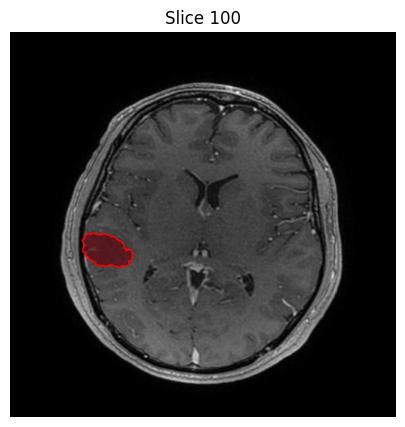

In [11]:
# pick a slice index
slice_idx = 100
img_t, mask_t = seg_dataset[slice_idx]

# move channels last (if needed) and numpy‑ify
img_arr  = img_t.squeeze(0).numpy()    # → (H, W)
mask_arr = mask_t.numpy()              # could be (1, H, W) or (H, W, 1)

# now force a 2D mask by squeezing *all* size‑1 dims
mask_2d = mask_arr.squeeze()           # → (H, W)

# plot
fig, ax = plt.subplots(figsize=(10, 5))
ax.imshow(img_arr, cmap="gray")
# overlay semi‑transparent red where mask==1
ax.imshow(np.ma.masked_where(mask_2d != 1, mask_2d),
          cmap="Reds", alpha=0.6, vmin=0, vmax=1)
# draw a crisp contour at the 0.5 level
ax.contour(mask_2d, levels=[0.5], colors="red", linewidths=1)
ax.axis("off")
ax.set_title(f"Slice {slice_idx}")
plt.show()

## Tumor Segmentation

We will use CNN models for binary semantic segmentation: predicting a tumor mask for each input MRI slice.
We will:
- Load a pretrained segmentation model (e.g., FCN).
- Train on the dataset using Dice or BCE loss.
- Visualize predictions and compare to ground truth.
- Benchmark multiple models (UNet, FCN, DeepLabV3).

In [12]:
clinical_df['Histopathology'].value_counts()

,count
Histopathology,
Astrocytoma,33
Glioblastoma,31
Oligodendroglioma,24
Dysembryoplastic neuroepithelial tumor,2
Metastatic Carcinoma from Lung Adenocarcinoma,2
Non-tumor destructive chronic inflammatory lesion with abnormal vasculature,1
Non-tumor epileptogenic brain parenchyma and gray matter,1
Papillary glioneuronal tumor,1
Atypical meningioma,1


Group less frequent histopathology types into 'Other'

In [13]:
histopathology_counts = clinical_df['Histopathology'].value_counts()
to_replace = histopathology_counts[histopathology_counts <= 2].index
clinical_df['Histopathology'] = clinical_df['Histopathology'].replace(to_replace, 'Other')
clinical_df['Histopathology'].value_counts()

,count
Histopathology,
Astrocytoma,33
Glioblastoma,31
Other,26
Oligodendroglioma,24


Exclude specified patients with faulty image/annotations/artifacts

In [14]:
excluded_patients = [7, 16, 4, 19, 22, 23, 27, 35, 41, 43, 47, 60, 76, 92, 95, 114]
clinical_df = clinical_df[~clinical_df['Case Number'].isin(excluded_patients)]
print(f"Number of patients after exclusion: {len(clinical_df)}")

Number of patients after exclusion: 98


Plotting all examples with tumors:


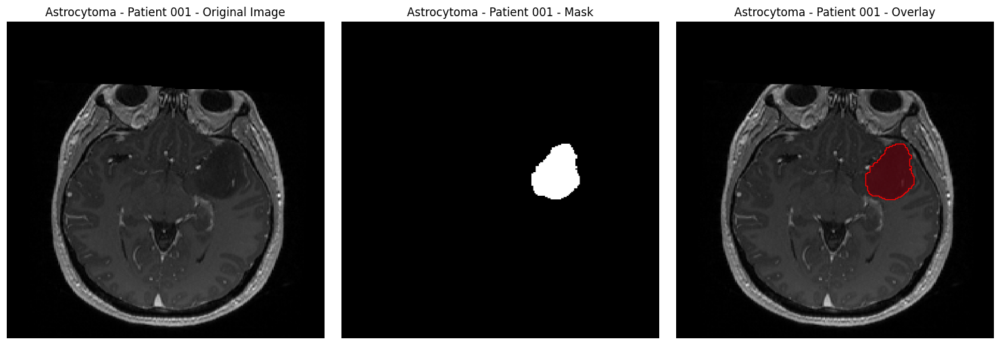

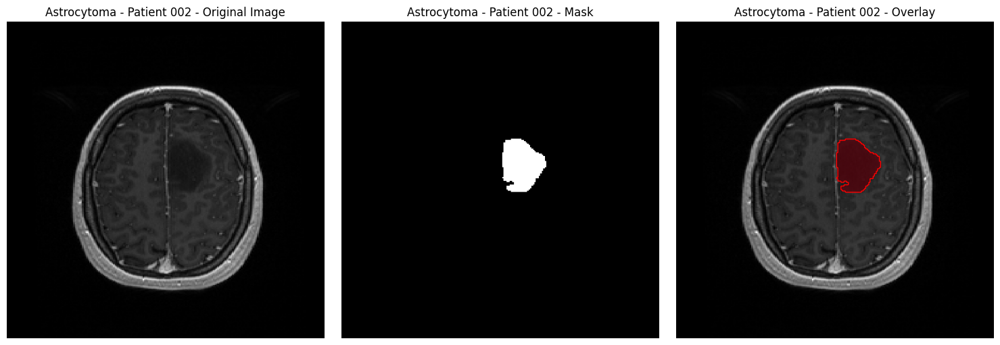

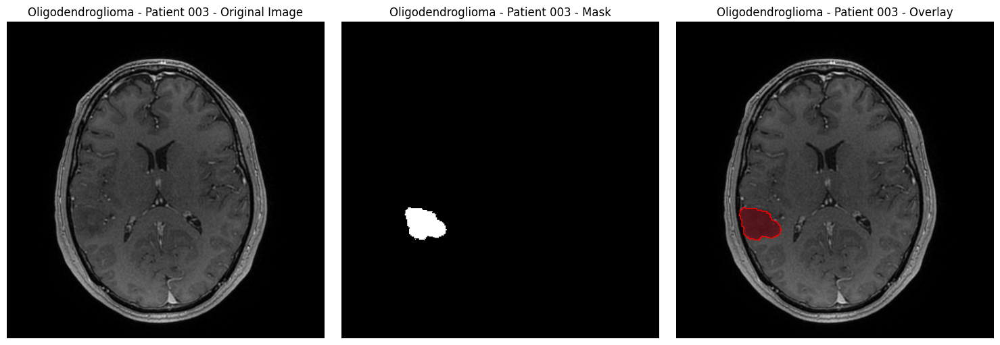

Data not found for patient 005. Skipping.


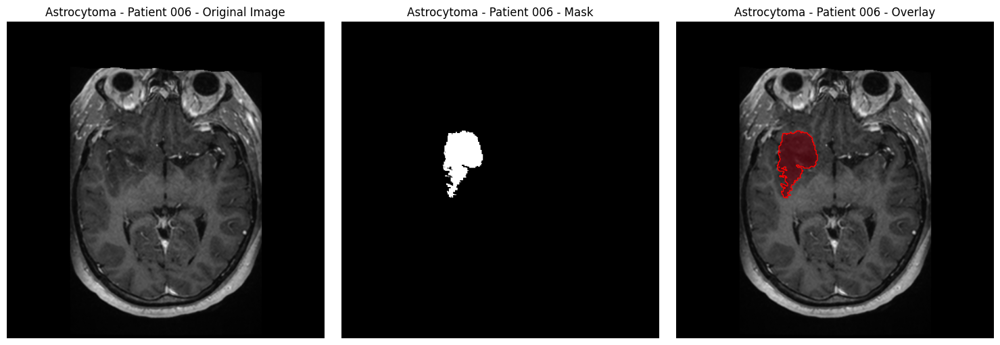

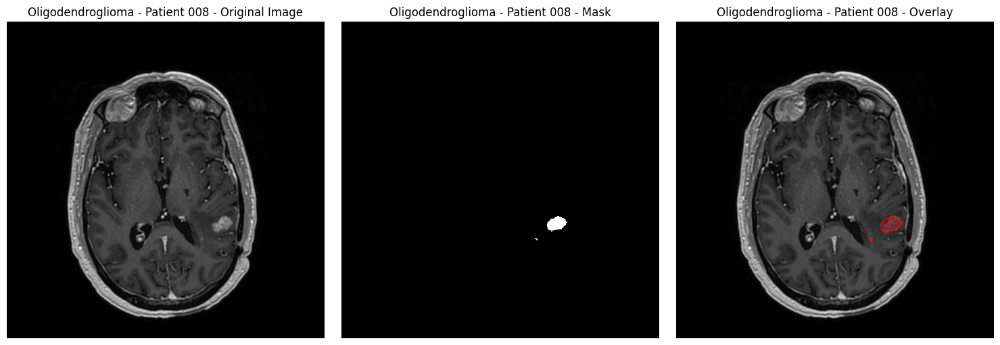

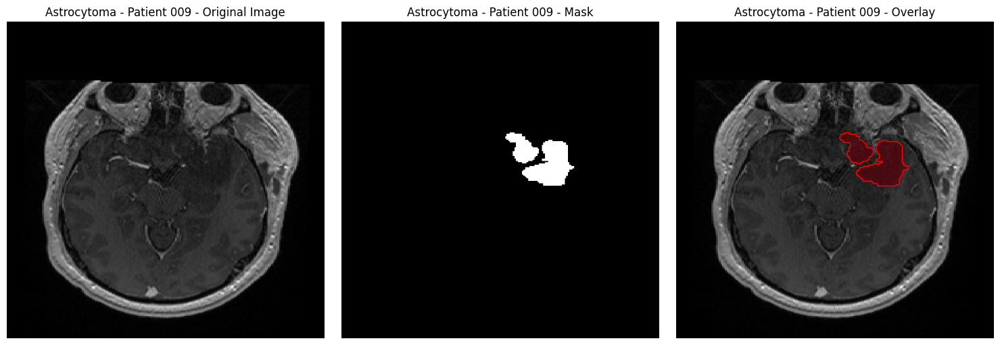

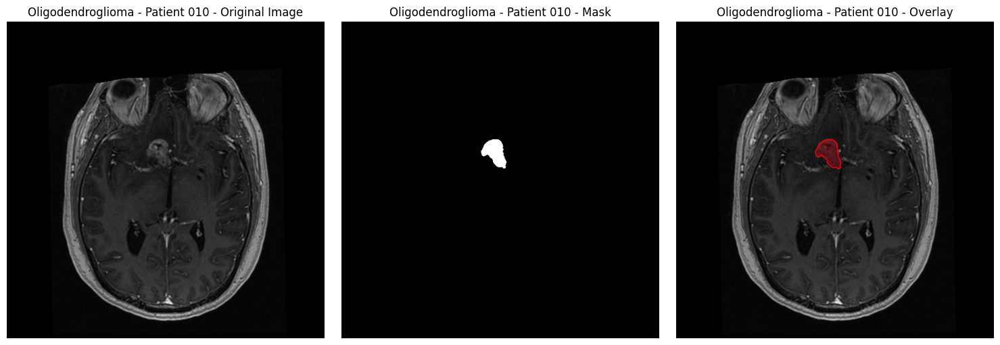

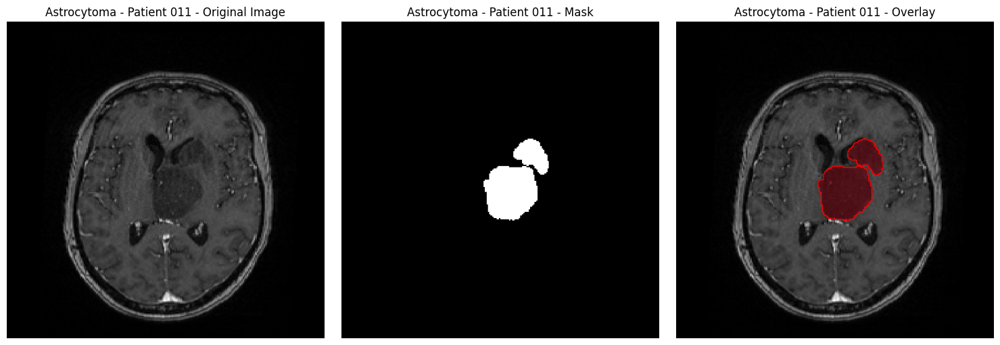

Data not found for patient 012. Skipping.


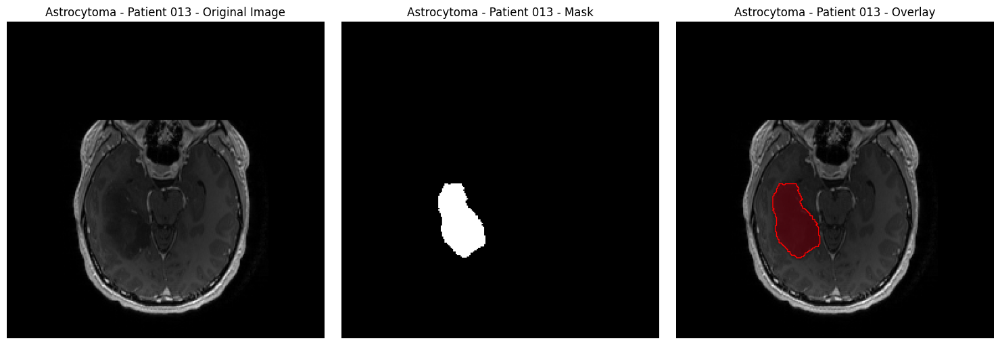

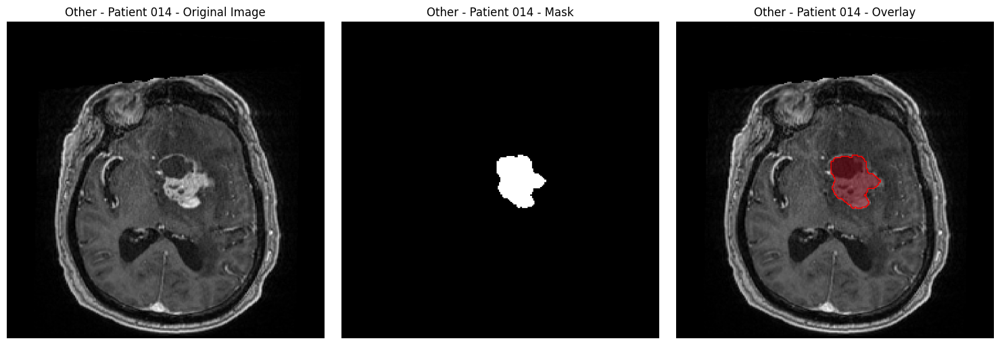

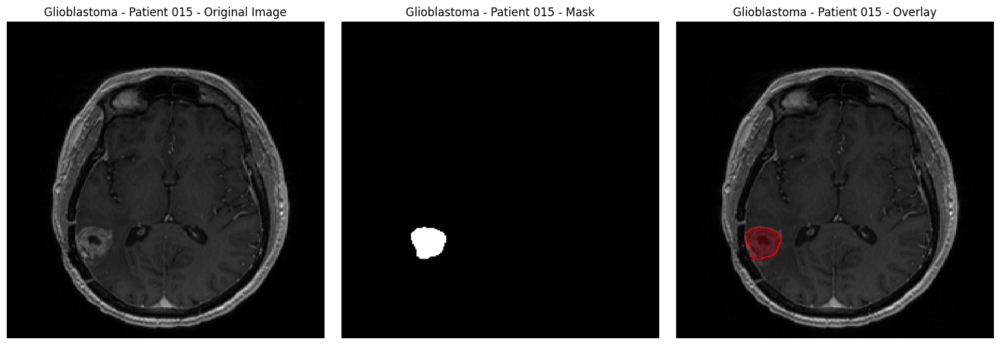

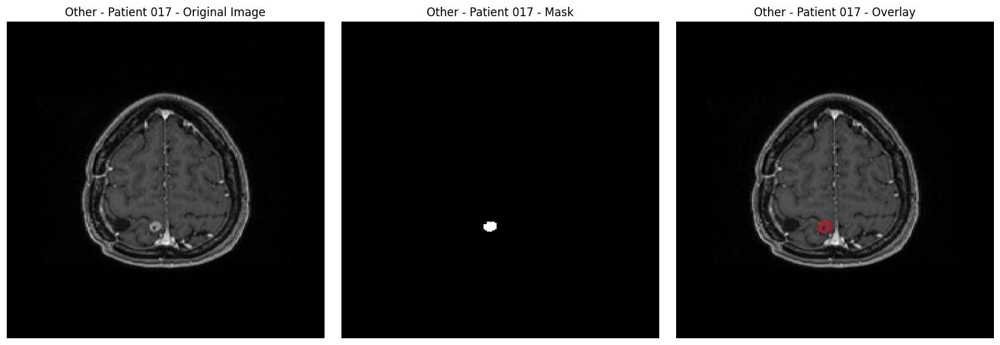

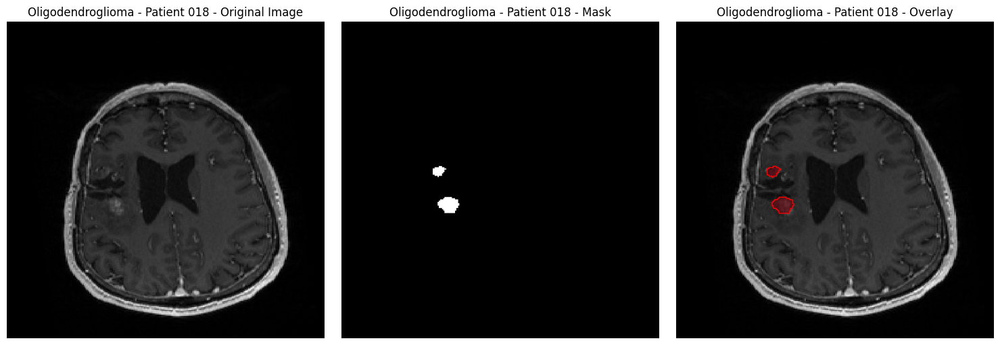

...

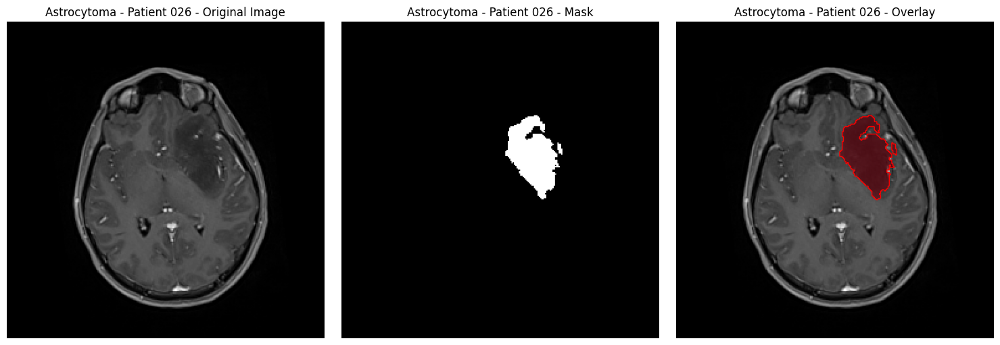

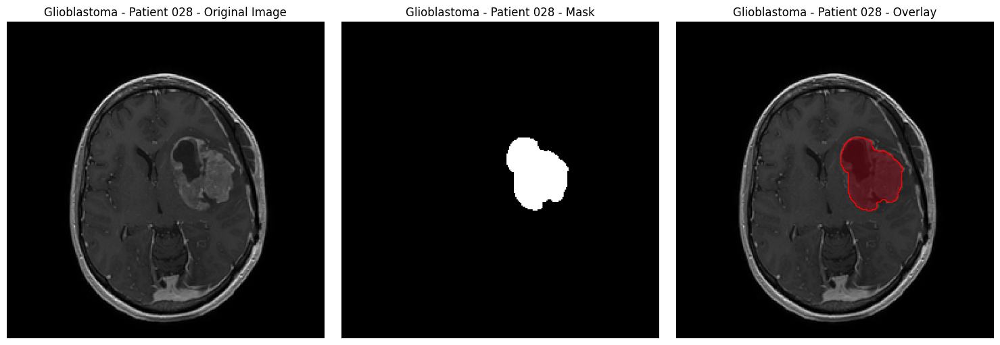

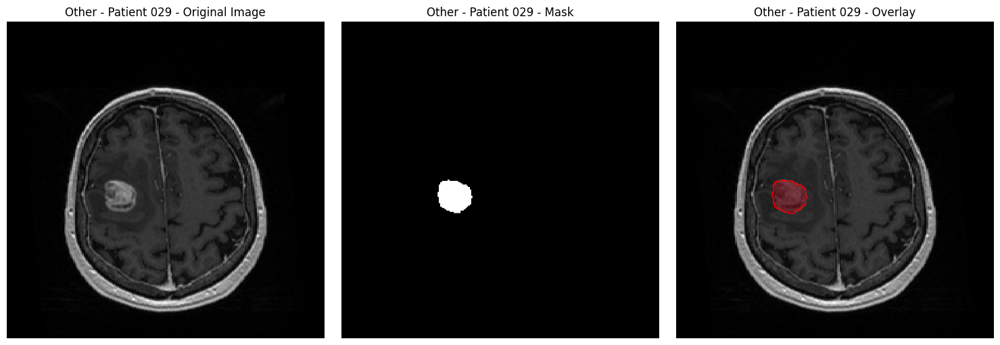

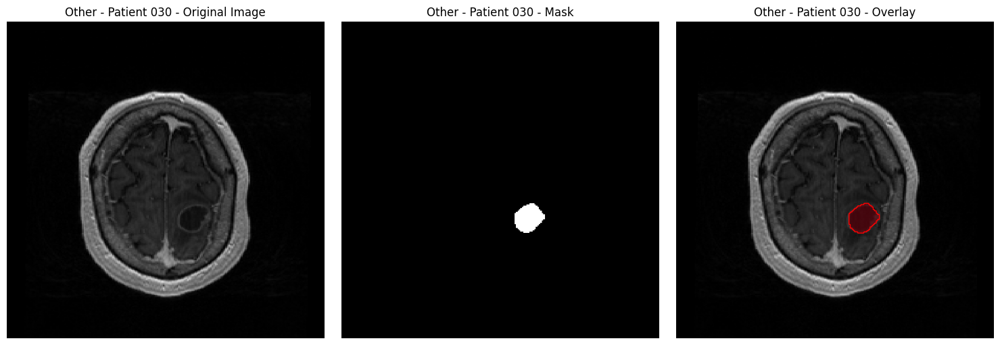

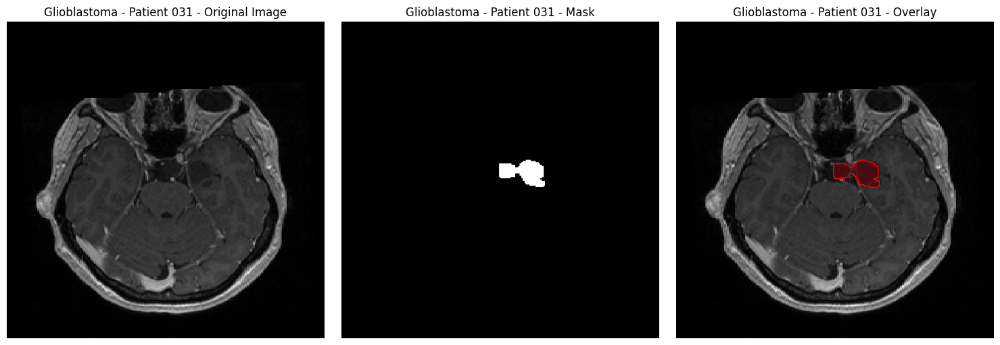

Data not found for patient 032. Skipping.
Data not found for patient 033. Skipping.


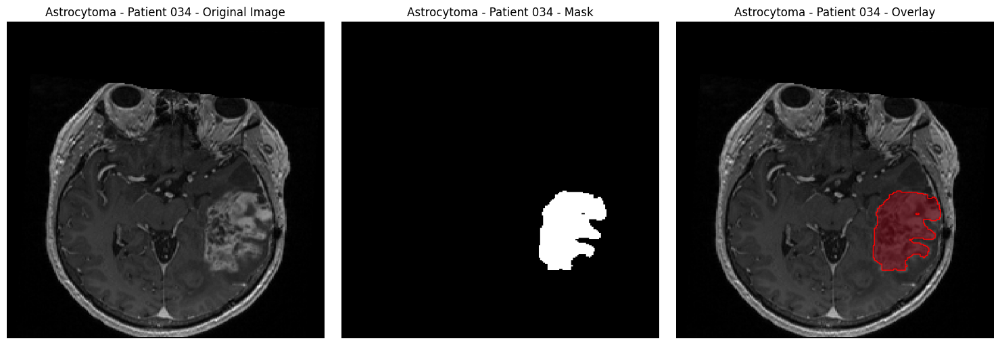

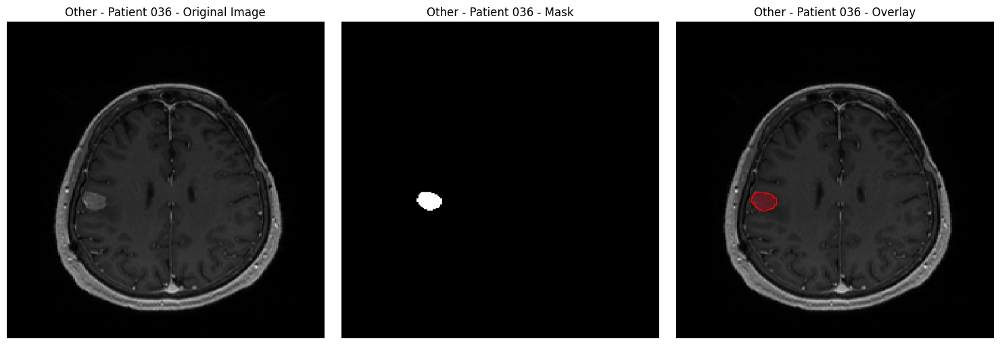

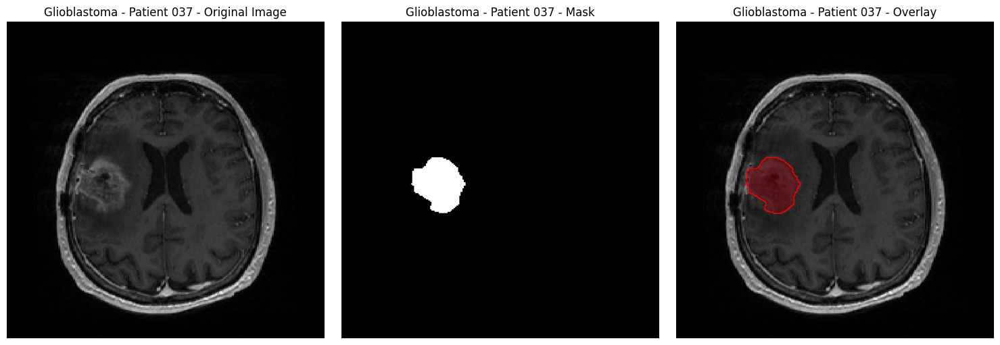

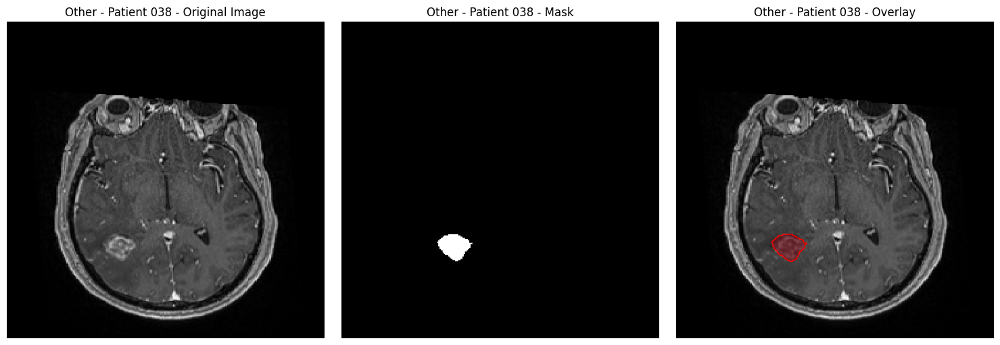

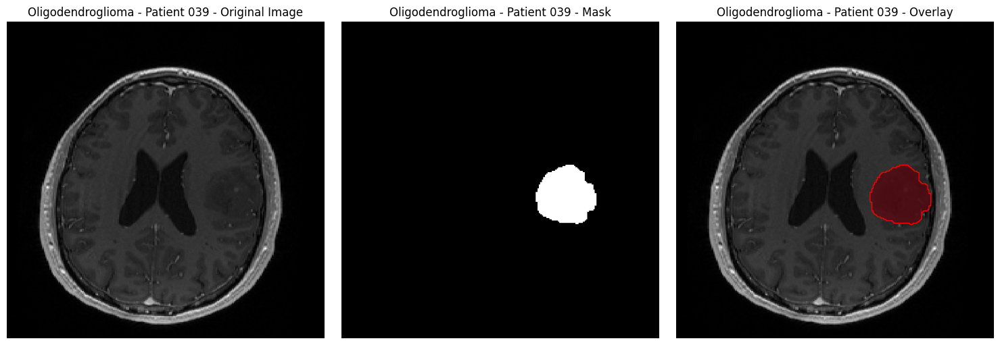

Data not found for patient 040. Skipping.


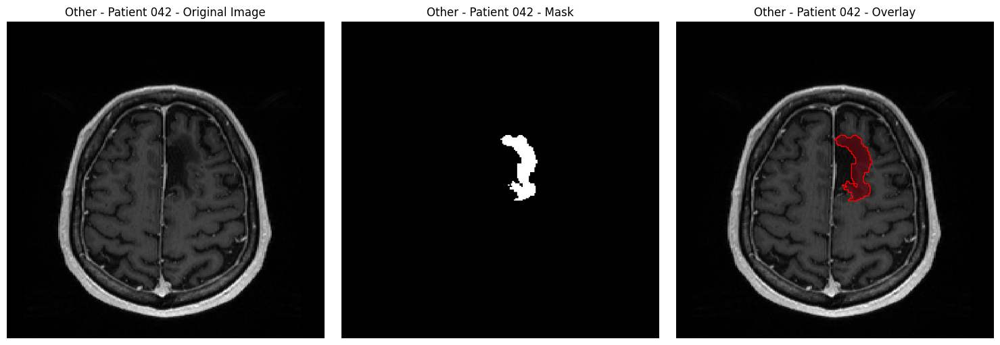

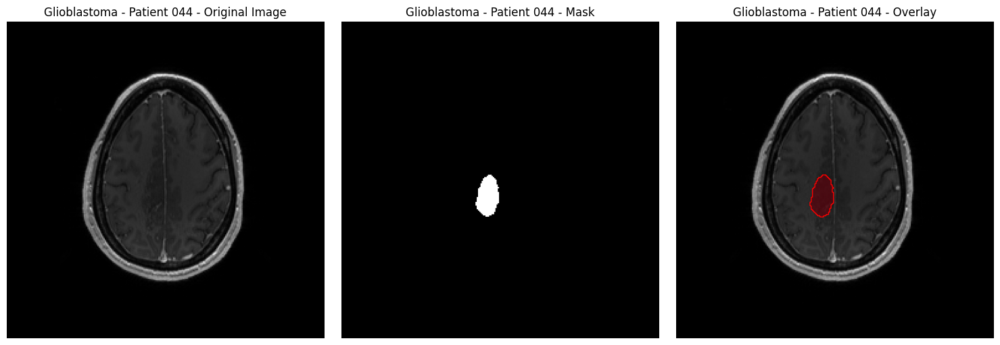

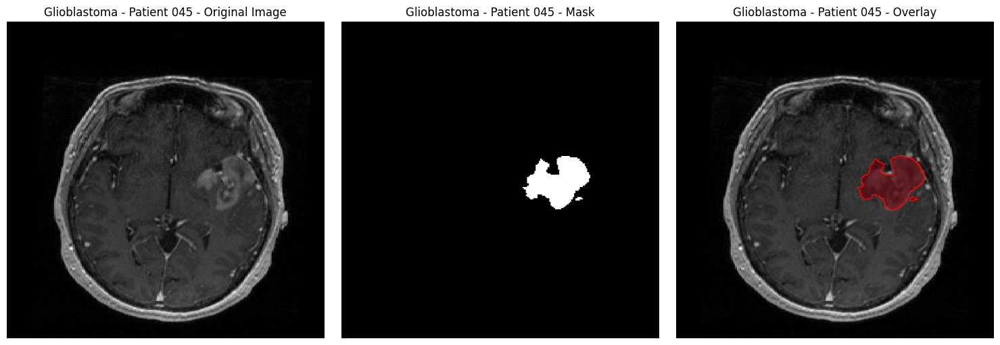

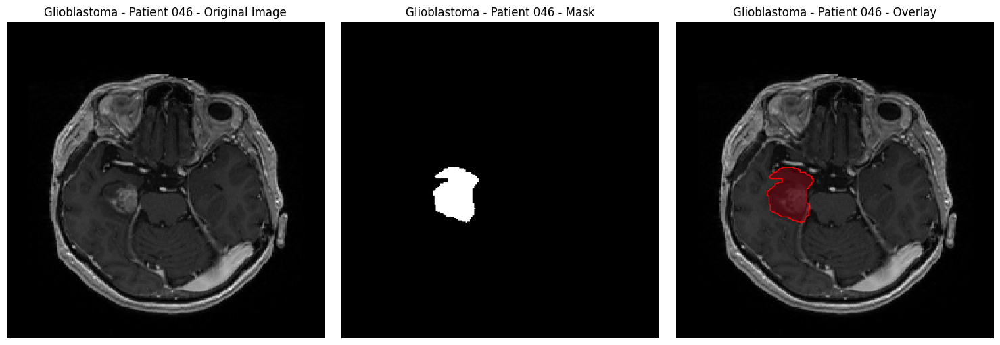

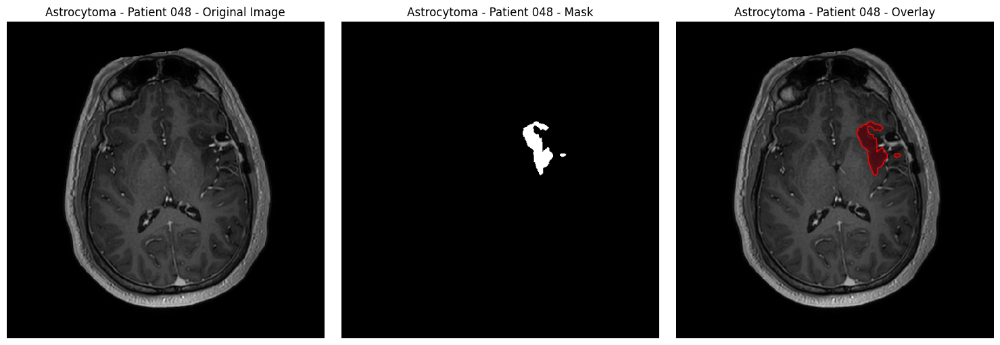

...

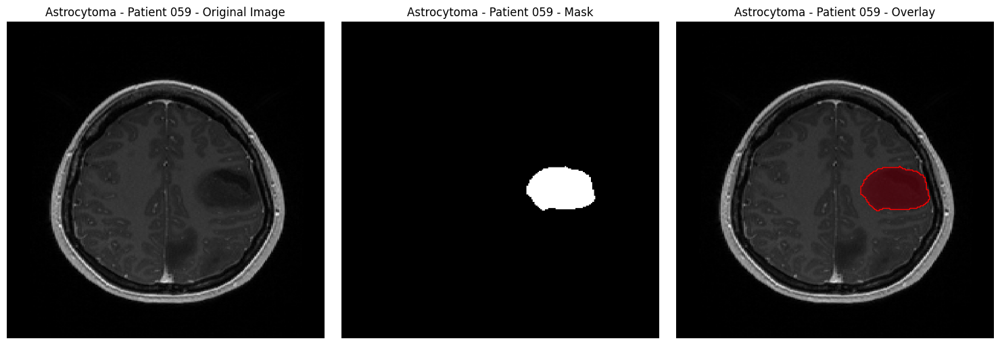

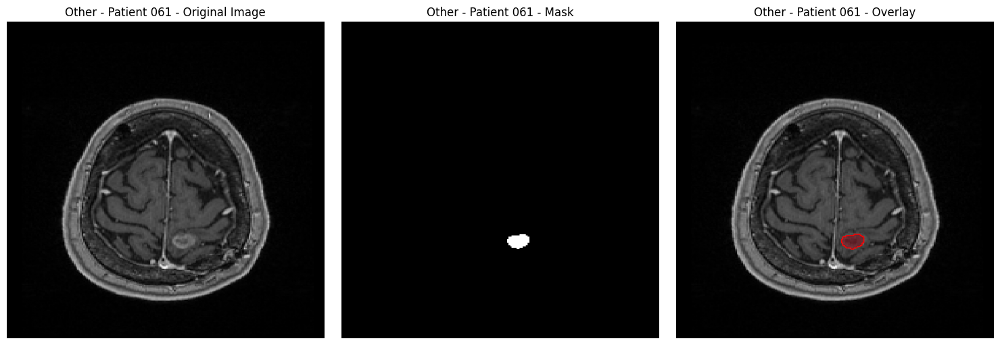

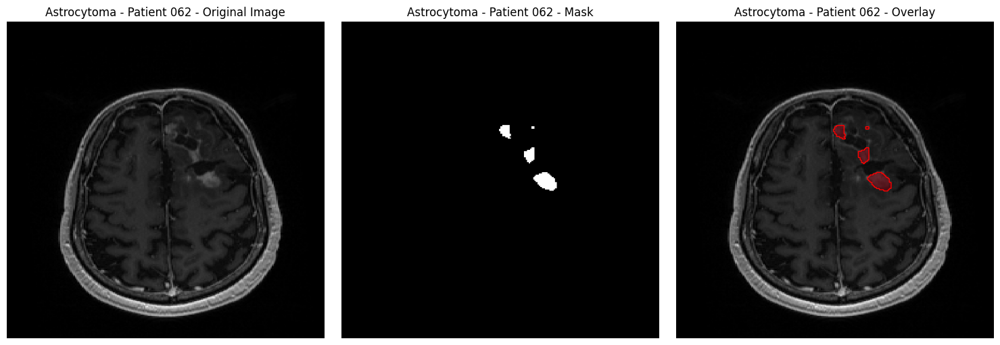

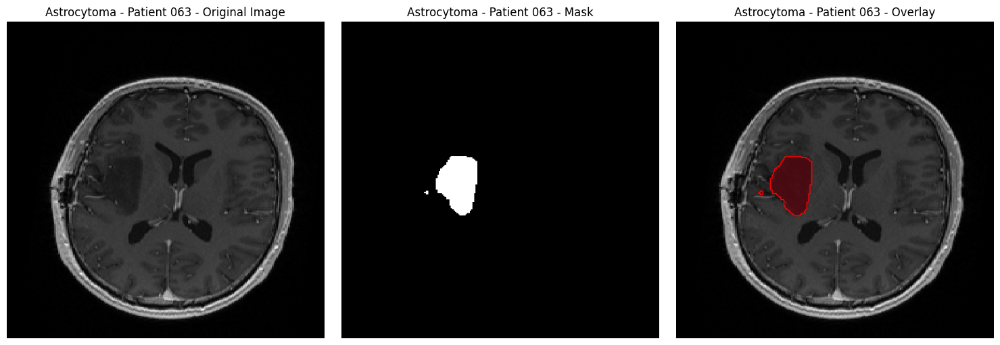

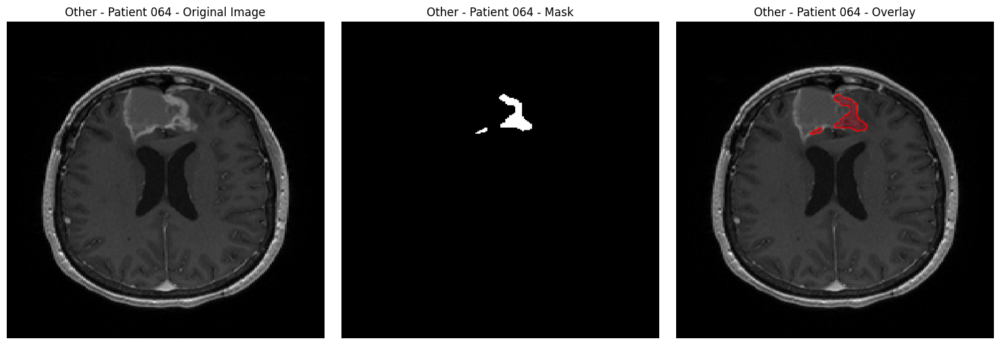

Data not found for patient 065. Skipping.


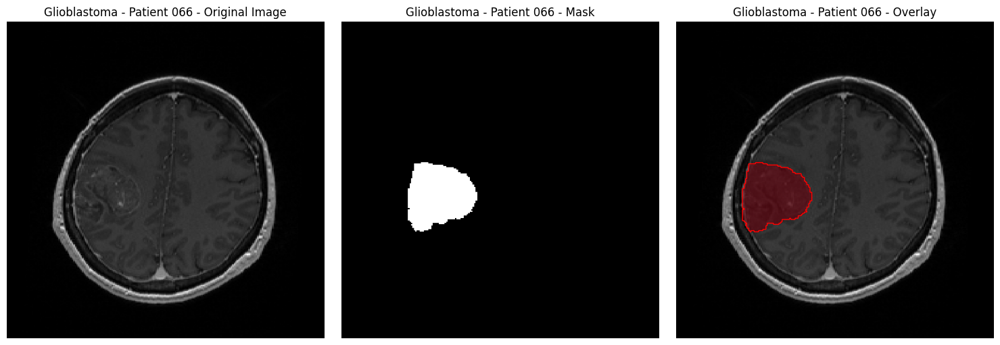

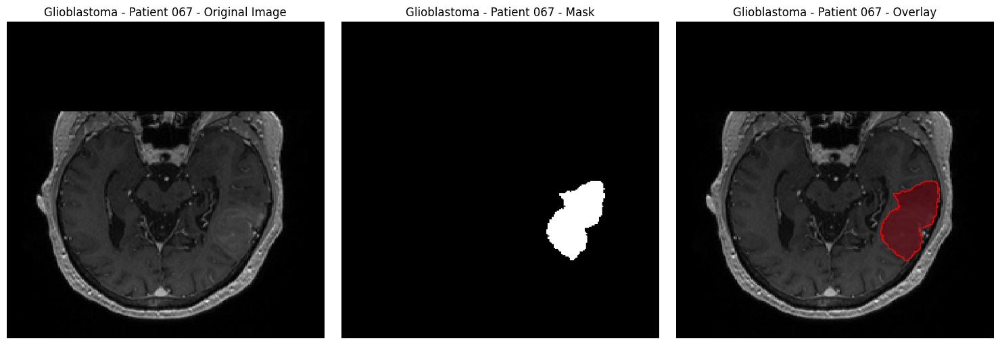

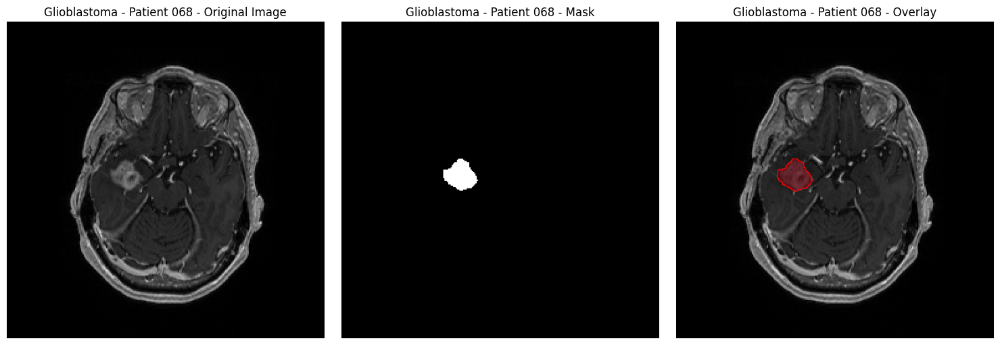

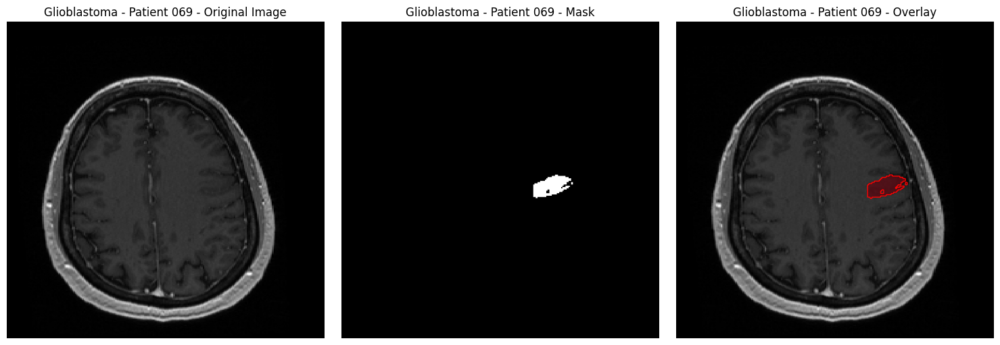

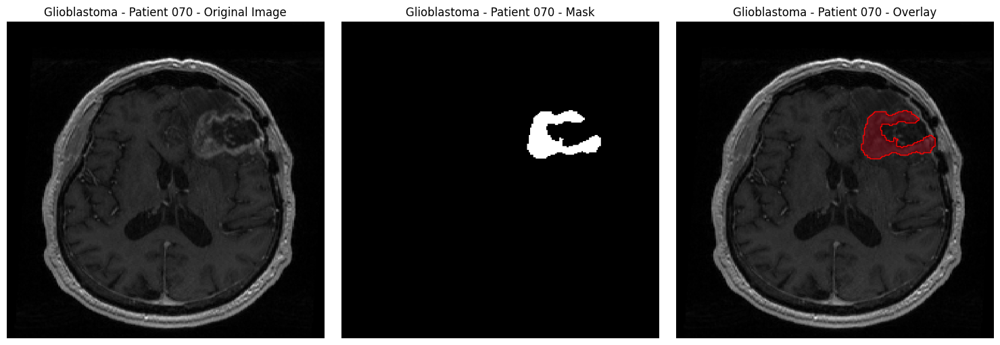

...

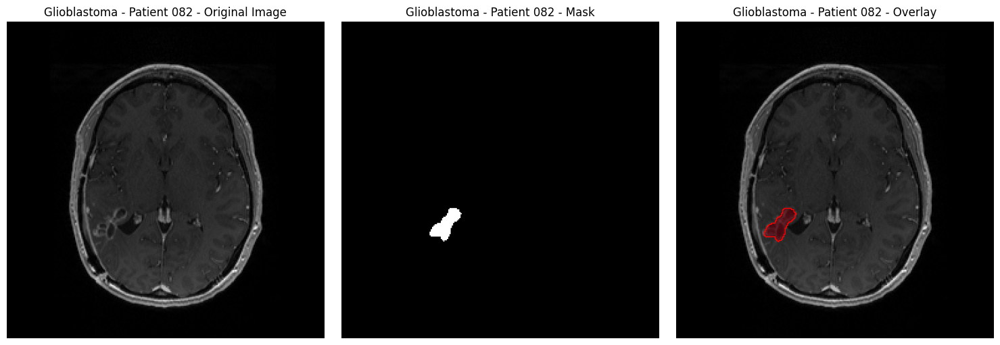

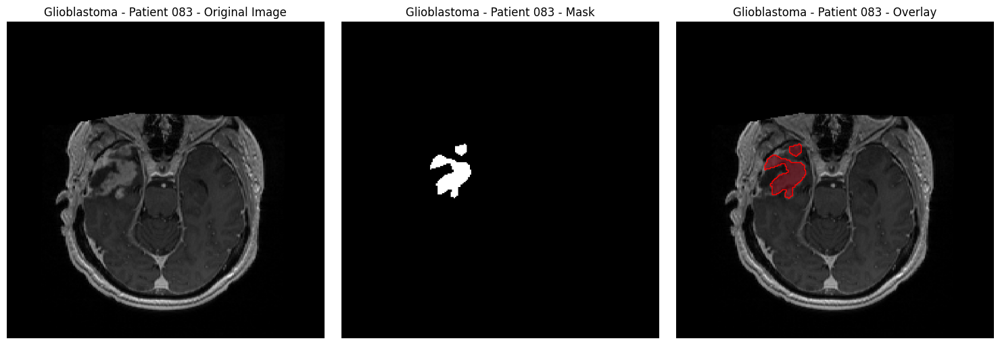

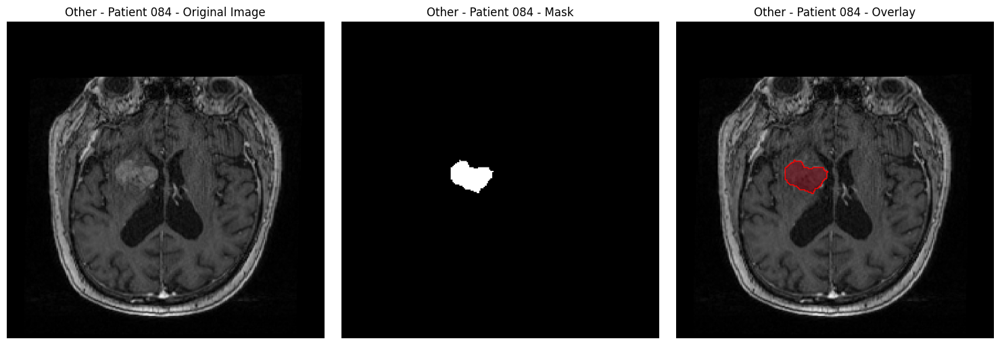

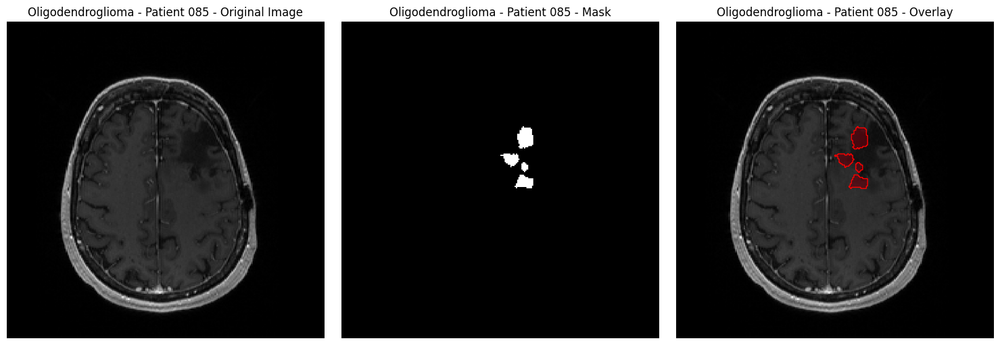

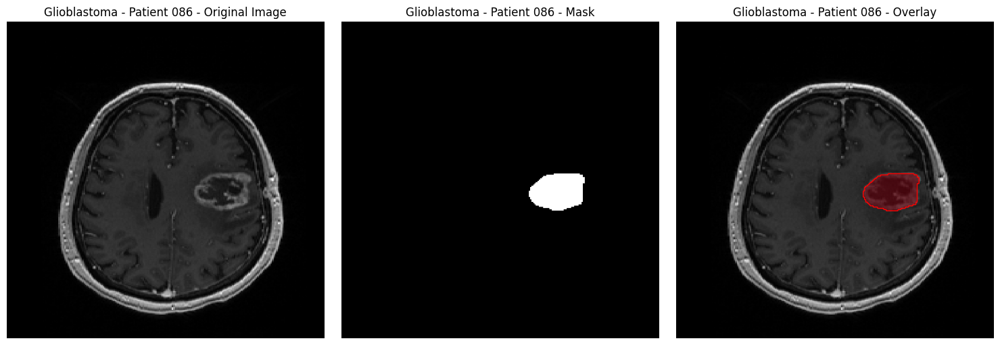

Data not found for patient 087. Skipping.


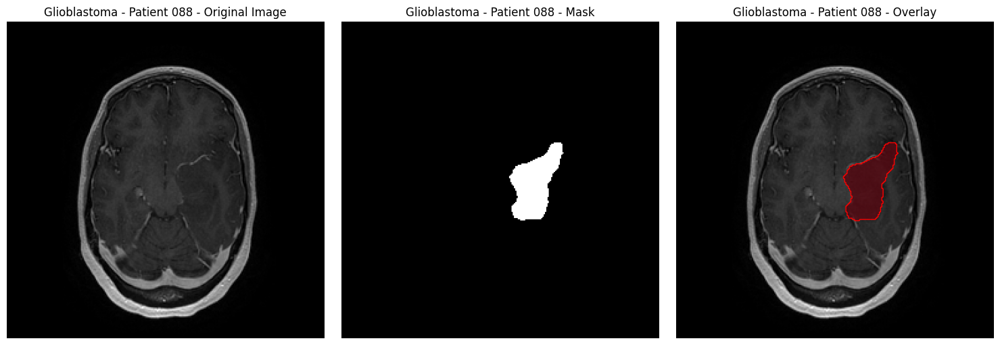

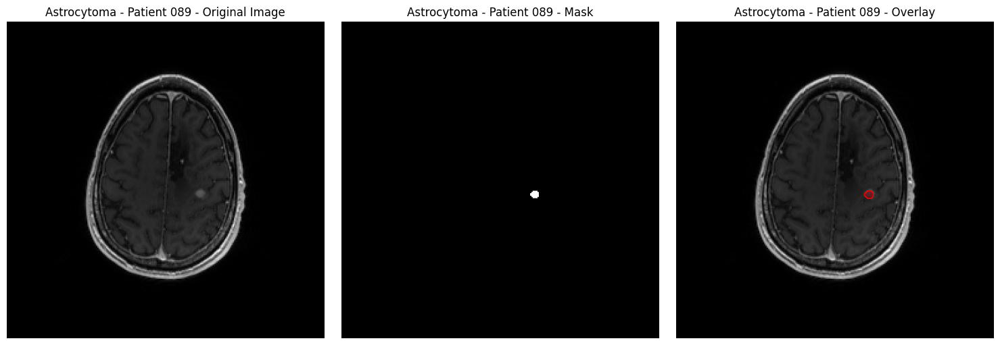

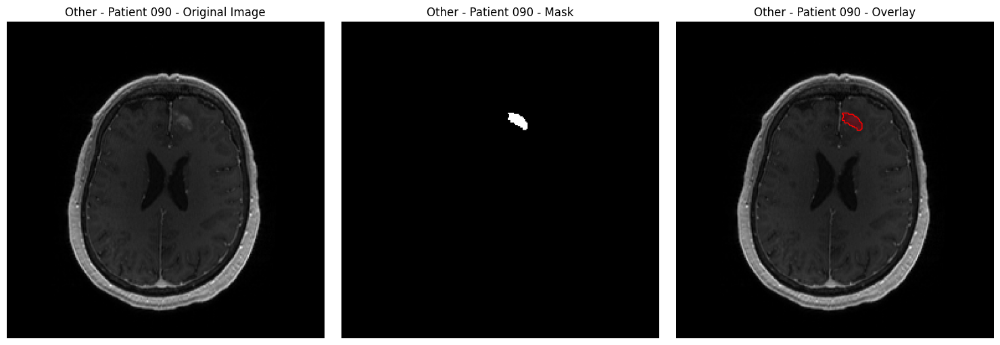

Data not found for patient 091. Skipping.


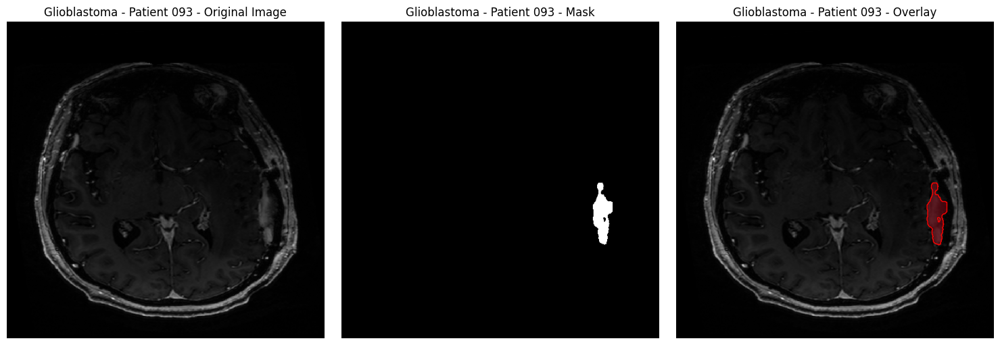

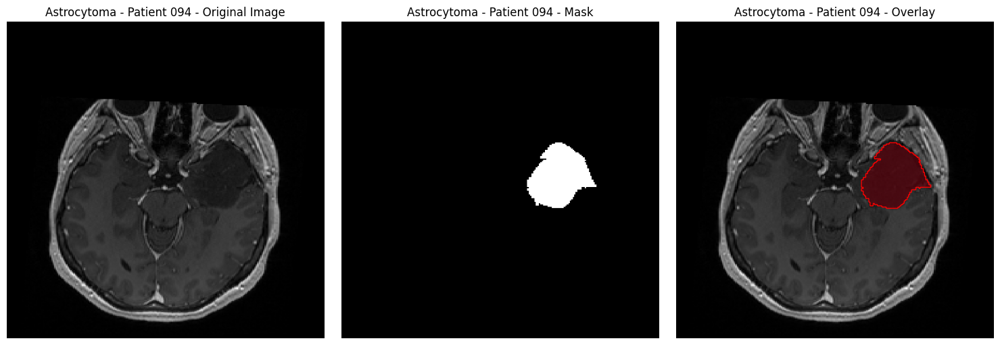

Data not found for patient 096. Skipping.


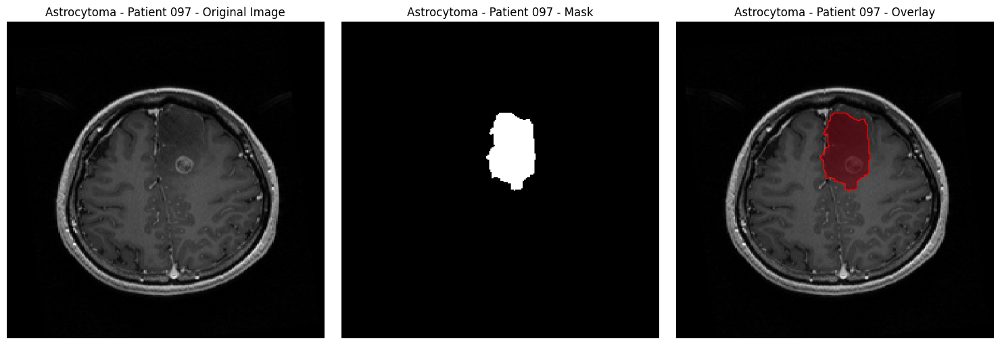

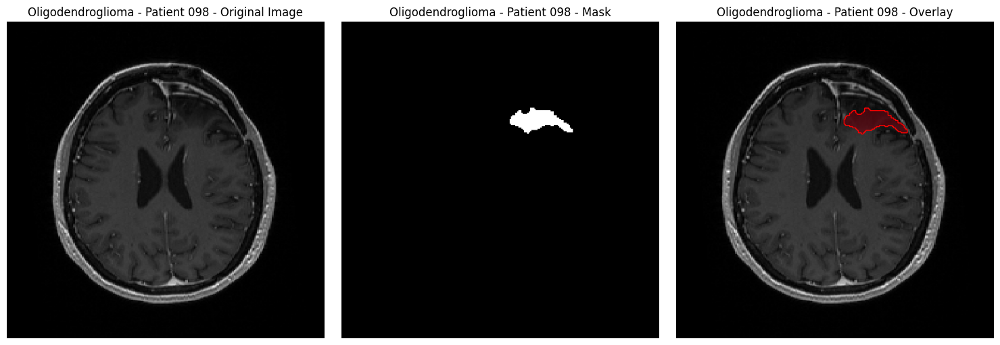

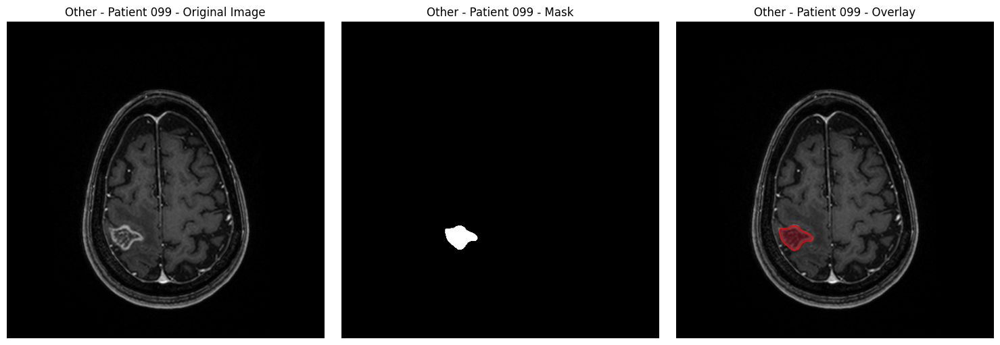

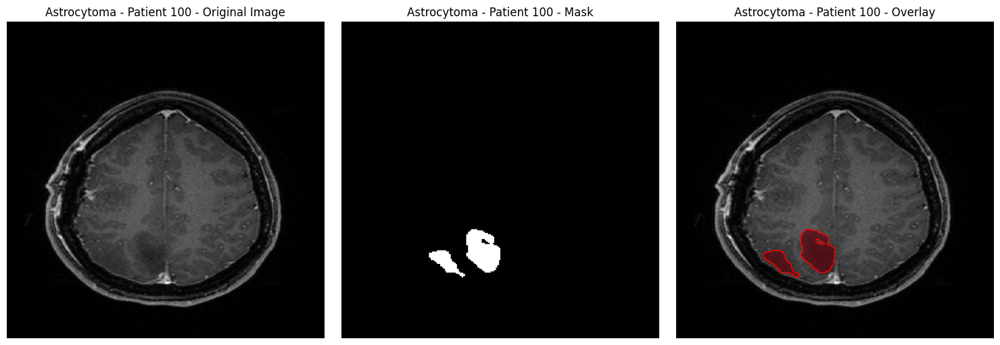

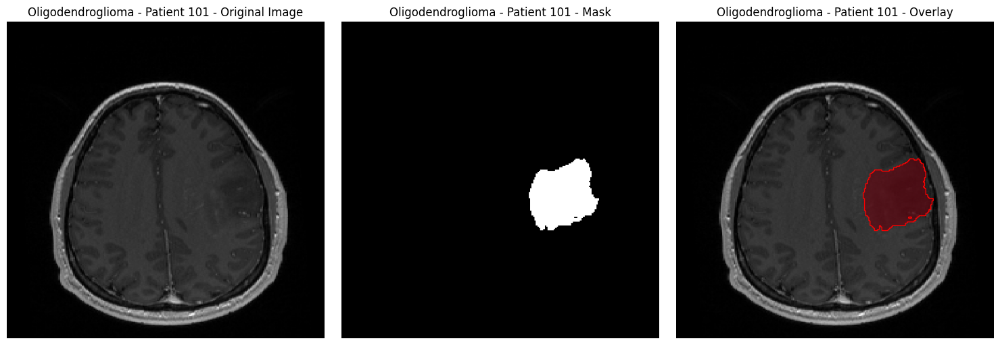

...

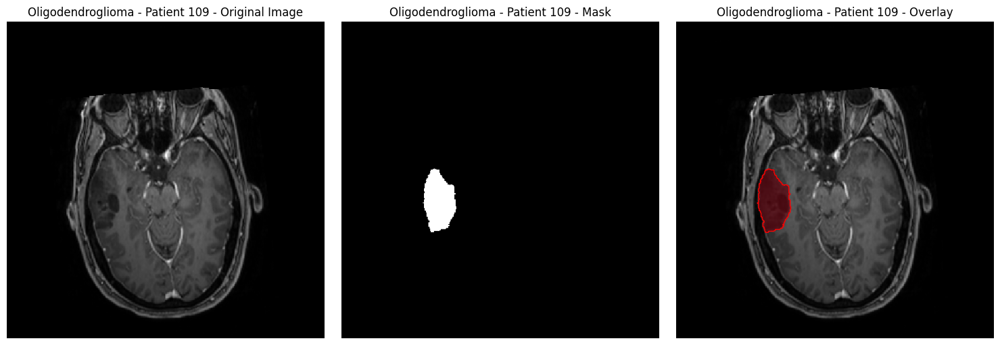

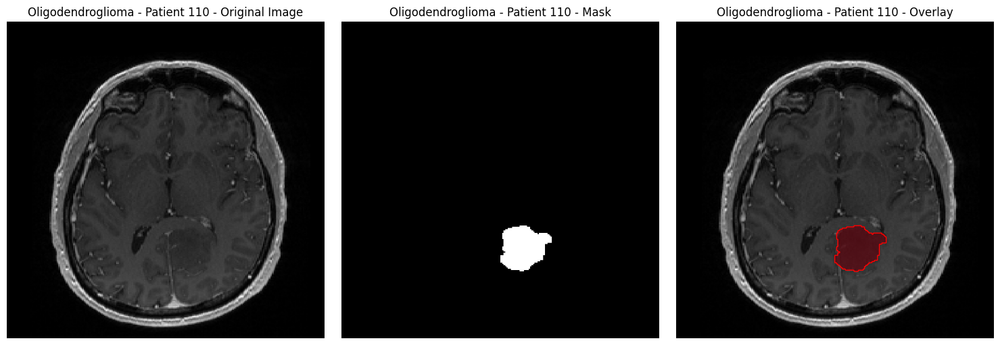

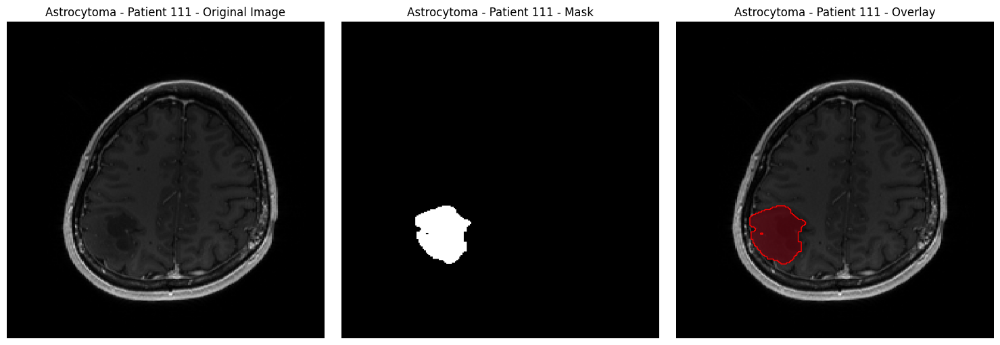

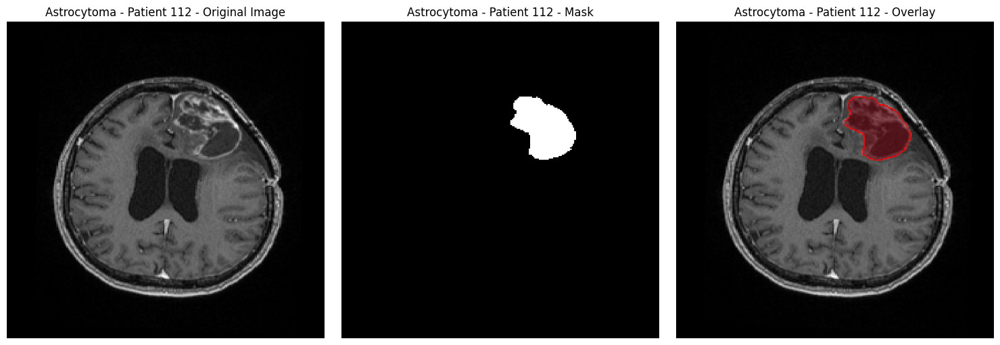

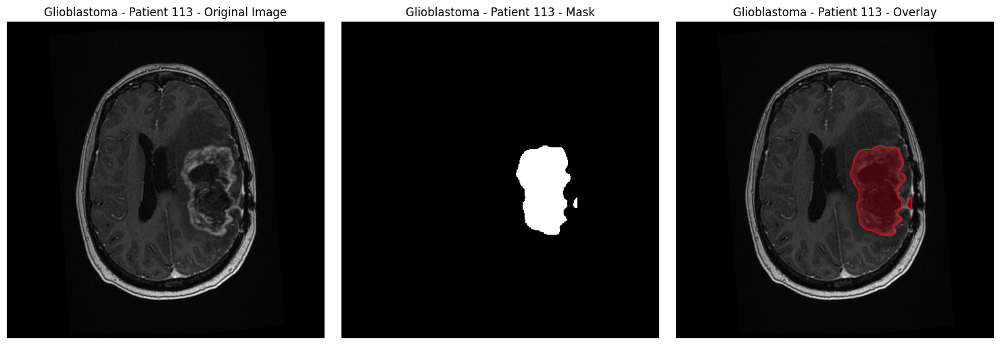

In [15]:
#@title Plot all examples with tumors
print("Plotting all examples with tumors:")

for index, row in clinical_df.iterrows():
    patient = row['Case Number']
    hist_type = row['Histopathology']
    idx = str(patient).zfill(3)
    img_dir = glob(f"{DATA_PATH}/data/ReMIND/sub-{idx}/anat/T1w*")
    seg_path = glob(f"{DATA_PATH}/data/ReMIND/sub-{idx}/seg/ReMIND-{idx}-preop-SEG-tumor-*.nrrd")

    if not img_dir or not seg_path:
        print(f"Data not found for patient {idx}. Skipping.")
        continue

    # Load volumes
    img_sitk = load_dicom_series_to_3d_image(img_dir[0])
    img_np = sitk.GetArrayFromImage(img_sitk)

    mask_sitk = sitk.ReadImage(seg_path[0])
    mask_sitk = reconstruct_mask_in_image_space(mask_sitk, img_sitk)
    mask_np = sitk.GetArrayFromImage(mask_sitk).astype(np.uint8)

    # Find a slice with a tumor (mask present)
    slices_with_tumor = [i for i, mask_slice in enumerate(mask_np) if mask_slice.any()]
    if not slices_with_tumor:
        print(f"No tumor slices found for patient {idx}. Skipping.")
        continue

    # Use the middle tumor slice for plotting if available, otherwise the first
    slice_to_plot_idx = slices_with_tumor[len(slices_with_tumor) // 2] if slices_with_tumor else 0

    img_slice = img_np[slice_to_plot_idx]
    mask_slice = mask_np[slice_to_plot_idx]

    # Convert image slice to float32 for consistency with Dataset
    img_slice = img_slice.astype(np.float32)

    # Apply transforms manually or use a simplified transform
    plot_img_t = A.Compose([A.Resize(512, 512, interpolation=0), A.Normalize(0.0, 1.0), ToTensorV2()])(image=img_slice)["image"].float()
    plot_mask_t = A.Compose([A.Resize(512, 512, interpolation=0), ToTensorV2(transpose_mask=True)])(image=img_slice, mask=mask_slice)["mask"]

    img_arr  = plot_img_t.squeeze(0).numpy()
    mask_arr = plot_mask_t.squeeze().numpy()

    # plot
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    ax[0].imshow(img_arr, cmap="gray")
    ax[0].set_title(f"{hist_type} - Patient {idx} - Original Image")
    ax[0].axis("off")

    ax[1].imshow(mask_arr, cmap="gray")
    ax[1].set_title(f"{hist_type} - Patient {idx} - Mask")
    ax[1].axis("off")

    ax[2].imshow(img_arr, cmap="gray")
    # overlay semi‑transparent red where mask==1
    ax[2].imshow(np.ma.masked_where(mask_arr != 1, mask_arr),
               cmap="Reds", alpha=0.6, vmin=0, vmax=1)
    # draw a crisp contour at the 0.5 level
    ax[2].contour(mask_arr, levels=[0.5], colors="red", linewidths=1)
    ax[2].set_title(f"{hist_type} - Patient {idx} - Overlay")
    ax[2].axis("off")

    plt.tight_layout()
    plt.show()

### Dataset split

Before, we need to split our dataset with training, validation and test sets.

<div class="alert alert-block alert-info">
<b>Q1.</b> Split the dataset using the <code>train_test_split</code> function from scikit-learn and create the three variables: <code>train_dataset</code>, <code>val_dataset</code>, <code>test_dataset</code>.
</div>

Get a unique list of patients and their corresponding labels for stratification

In [16]:
patient_data = clinical_df[['Case Number', 'Histopathology']].drop_duplicates().set_index('Case Number')
patient_list = patient_data.index.to_numpy()
patient_labels = patient_data['Histopathology'].to_numpy()

First Split: Separate the training data (70%) from a temporary set (30%).
This temporary set will become our validation and test sets.

In [17]:
patient_train, patient_temp, labels_train, labels_temp = train_test_split(
    patient_list,
    patient_labels,
    test_size=0.3, # 30% of data will be for validation and testing
    stratify=patient_labels,
    random_state=42
)

Second Split: Split the temporary set (30%) into validation (10%) and test (20%). We want the test set to be 2/3 of this temp set (20% of original total) and the validation set to be 1/3 (10% of original total).

In [18]:
patient_val, patient_test, _, _ = train_test_split(
    patient_temp,
    labels_temp,
    test_size=(2/3), # 20% is 2/3 of 30%
    stratify=labels_temp,
    random_state=42
)


Create the final dataframes

In [19]:
train_df = clinical_df[clinical_df['Case Number'].isin(patient_train)]
val_df = clinical_df[clinical_df['Case Number'].isin(patient_val)]
test_df = clinical_df[clinical_df['Case Number'].isin(patient_test)]

print(f"Total patients: {len(patient_list)}")
print(f"Training patients:   {len(patient_train)} (~{len(patient_train)/len(patient_list):.0%})")
print(f"Validation patients: {len(patient_val)} (~{len(patient_val)/len(patient_list):.0%})")
print(f"Test patients:       {len(patient_test)} (~{len(patient_test)/len(patient_list):.0%})")
print("Stratification check (Histopathology distribution):")
print("\nTraining Set Distribution:\n", train_df['Histopathology'].value_counts(normalize=True))
print("\nValidation Set Distribution:\n", val_df['Histopathology'].value_counts(normalize=True))
print("\nTest Set Distribution:\n", test_df['Histopathology'].value_counts(normalize=True))

Total patients: 98
Training patients:   68 (~69%)
Validation patients: 10 (~10%)
Test patients:       20 (~20%)
Stratification check (Histopathology distribution):

Training Set Distribution:
 Histopathology
Astrocytoma          0.323529
Glioblastoma         0.264706
Oligodendroglioma    0.220588
Other                0.191176
Name: proportion, dtype: float64

Validation Set Distribution:
 Histopathology
Glioblastoma         0.3
Astrocytoma          0.3
Other                0.2
Oligodendroglioma    0.2
Name: proportion, dtype: float64

Test Set Distribution:
 Histopathology
Astrocytoma          0.30
Oligodendroglioma    0.25
Glioblastoma         0.25
Other                0.20
Name: proportion, dtype: float64


Load the DICOM datasets once

In [20]:
train_ds = SegmentationDataset(train_df, DATA_PATH)
val_ds = SegmentationDataset(val_df, DATA_PATH)

Indexing slices: 100%|██████████| 10/10 [00:07<00:00,  1.34it/s]


Lets visulize some examples from our dataloader

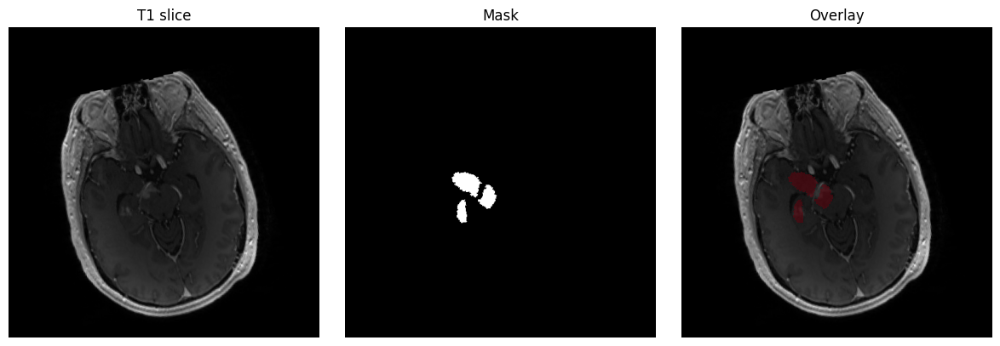

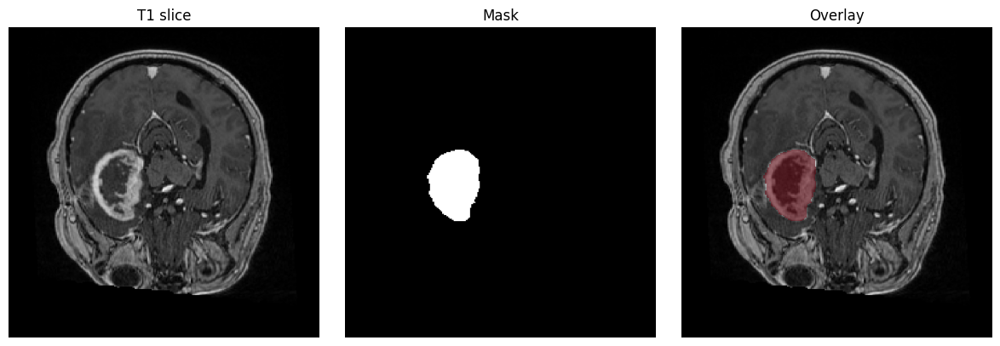

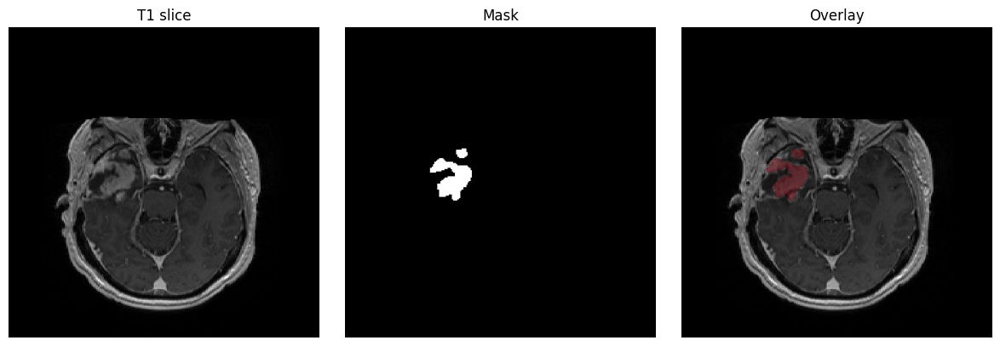

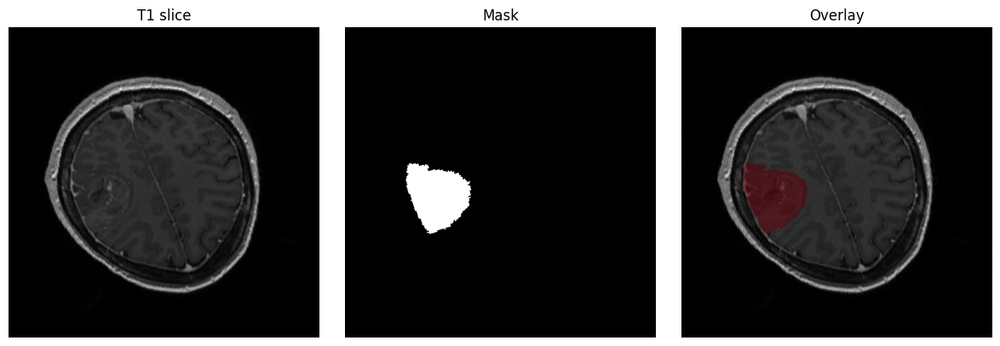

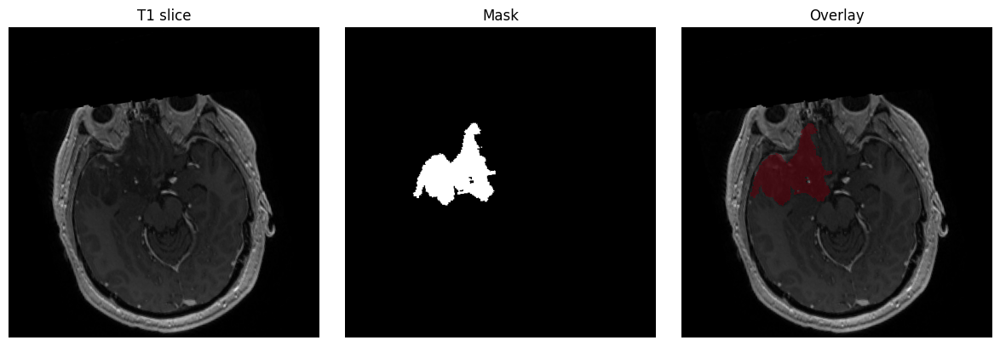

...

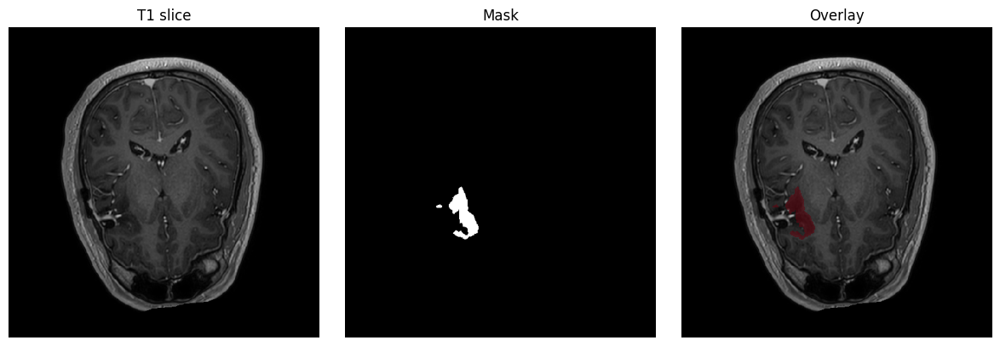

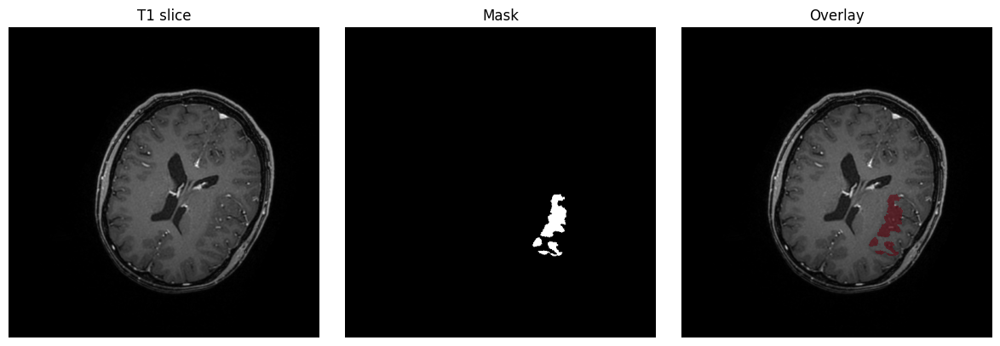

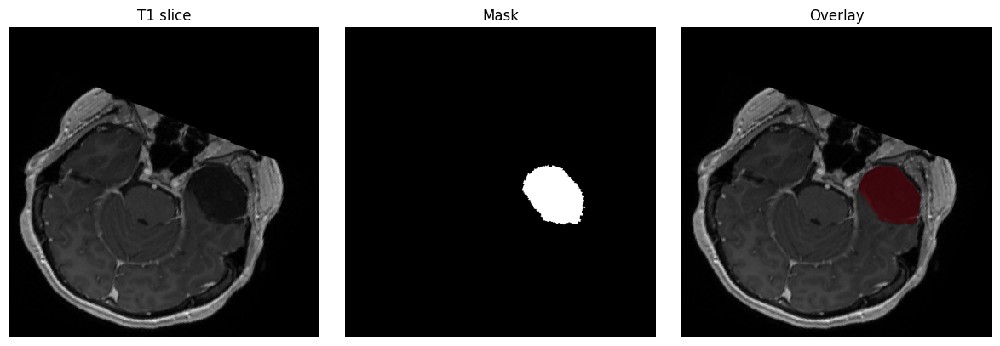

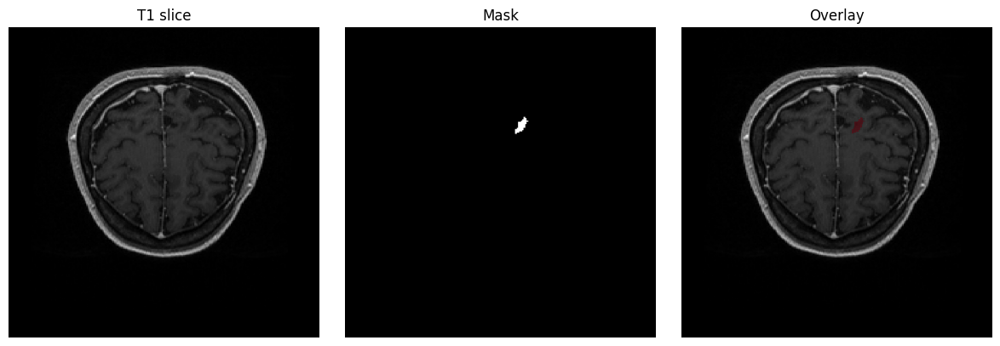

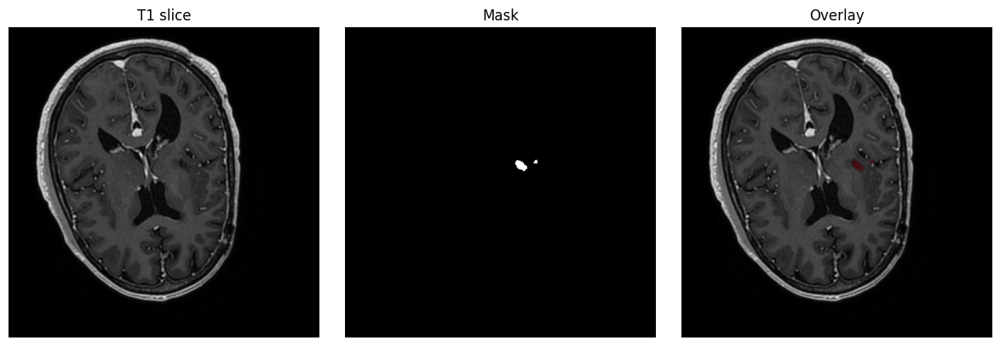

In [21]:
#@title dataloader visualization
# assume `train_dataset` is your SegmentationDataset
loader = DataLoader(
    train_ds,
    batch_size=32,
    shuffle=True,
    num_workers=2,
    pin_memory=True,
)

# grab a single batch
imgs, masks = next(iter(loader))
# imgs: [B,1,H,W], masks: [B,1,H,W]

# step 1: remove the channel dimension → [B,H,W]
# this will NOT touch your H/W dims
masks_2d = masks.squeeze(1)   # only squeezes axis=1, leaving (B,H,W)

for i in range(imgs.size(0)):
    img  = imgs[i, 0].cpu().numpy()         # (H,W)
    mask = masks_2d[i].cpu().numpy().astype(int)  # (H,W), values {0,1}

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4))

    # plain image
    ax1.imshow(img, cmap="gray")
    ax1.set_title("T1 slice")
    ax1.axis("off")

    # raw mask (2D)
    ax2.imshow(mask, cmap="gray", vmin=0, vmax=1)
    ax2.set_title("Mask")
    ax2.axis("off")

    # overlay
    ax3.imshow(img, cmap="gray")
    ax3.imshow(
        np.ma.masked_where(mask == 0, mask),  # zeros become transparent
        cmap="Reds",
        alpha=0.5,
        vmin=0,
        vmax=1,
        interpolation="none"
    )
    ax3.set_title("Overlay")
    ax3.axis("off")

    plt.tight_layout()
    plt.show()

In the following, we will create and fine-tune a segmentation network named FCN. Always inspect the in_channels of the layer you’re replacing, and patch both main and auxiliary classifiers so they match your desired number of output classes.

We will add a dropout to our model as a regularization technique

In [22]:
import segmentation_models_pytorch as smp
class UnetWithBottleneckDropout(smp.Unet):
    def __init__(self,
                 encoder_name="resnet50",
                 encoder_weights="imagenet",
                 in_channels=1,
                 classes=1,
                 dropout=0.2):
        super().__init__(
            encoder_name   = encoder_name,
            encoder_weights= encoder_weights,
            in_channels    = in_channels,
            classes        = classes,
        )
        self.bottleneck_dropout = nn.Dropout2d(p=dropout)

    def forward(self, x):
        # 1) get the encoder features (list of 5 feature maps)
        features = self.encoder(x)
        # 2) drop out only the bottleneck (last) feature
        features[-1] = self.bottleneck_dropout(features[-1])
        # 3) feed *the entire list* to the decoder
        decoder_output = self.decoder(features)        # <- pass list, not splat
        # 4) segmentation head as usual
        masks = self.segmentation_head(decoder_output)
        return masks

In [23]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UnetWithBottleneckDropout(
    encoder_name   ="resnet50",
    encoder_weights="imagenet",
    in_channels    =1,
    classes        =1,
    dropout        =0.2,
).to(device)
print(model)


UnetWithBottleneckDropout(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample

In [24]:
import segmentation_models_pytorch as smp
from torch.optim.lr_scheduler import CosineAnnealingLR

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = smp.Unet(
    encoder_name="resnet50",
    encoder_weights="imagenet",
    in_channels=1,
    classes=1,
    # attention_type='scse'
).to(device)

# model = smp.Unet(encoder_name="resnet50", encoder_weights="imagenet", in_channels=1, classes=1) # Binary class
model.to(device)
print(model)

Unet(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
      

<div class="alert alert-block alert-info">
<b>Q2.</b> In the following cell, we implemented the training loop for segmentation. Implement the corresponding validation loop.
</div>

In [25]:
def train_epoch(model, loader, criterion, optimizer, scaler, device):
    model.train()
    epoch_loss = 0.0
    pbar = tqdm(loader, desc="Train", leave=False)
    for imgs, masks in pbar:
        imgs, masks = imgs.to(device), masks.to(device)
        optimizer.zero_grad(set_to_none=True)
        with torch.cuda.amp.autocast(enabled=scaler is not None):
            preds = model(imgs)
            loss = criterion(preds, masks)
        if scaler is not None:
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
        else:
            loss.backward()
            optimizer.step()
        epoch_loss += loss.item() * imgs.size(0)
    return epoch_loss / len(loader.dataset)


# def validate(model, loader, criterion, device):
#     model.eval()
#     val_loss = 0.0
#     dices = []
#     with torch.no_grad():
#         for imgs, masks in tqdm(loader, desc="Val", leave=False):
#             imgs, masks = imgs.to(device), masks.to(device)
#             preds = model(imgs)
#             loss = criterion(preds, masks)
#             val_loss += loss.item() * imgs.size(0)
#             dices.append(dice_coefficient(preds.cpu(), masks.cpu()))
#     return val_loss / len(loader.dataset), np.mean(dices)

# def dice_coefficient(pred: torch.Tensor, target: torch.Tensor, eps: float = 1e-6):
#     pred = torch.sigmoid(pred) > 0.5
#     intersection = (pred & (target > 0.5)).float().sum(dim=(1, 2, 3))
#     union = pred.float().sum(dim=(1, 2, 3)) + target.float().sum(dim=(1, 2, 3))
#     dice = (2.0 * intersection + eps) / (union + eps)
#     return dice.mean().item()

def validate(model, loader, criterion, device):
    model.eval()
    val_loss = 0.0
    val_dice = 0.0
    with torch.no_grad():
        for imgs, masks in tqdm(loader, desc="Validating", leave=False):
            imgs, masks = imgs.to(device), masks.to(device)
            logits = model(imgs)
            val_loss += criterion(logits, masks).item()
            val_dice += dice_coefficient(logits, masks).item()
    return val_loss / len(loader), val_dice / len(loader)

# --- CORRECTED METRIC FUNCTION ---
def dice_coefficient(logits, targets, smooth=1.0):
    """Calculates the Dice coefficient metric."""
    preds = (torch.sigmoid(logits) > 0.5).float()

    # Flatten both tensors to a 1D array
    preds_flat = preds.view(-1)
    targets_flat = targets.view(-1)

    intersection = (preds_flat * targets_flat).sum()

    # Use the 'smooth' argument, not 'self.smooth'
    union = preds_flat.sum() + targets_flat.sum()
    dice_score = (2. * intersection + smooth) / (union + smooth)

    return dice_score

In [1]:
import torch
import os
from torch.utils.data import DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
checkpoint_dir= "./checkpoint/"
os.makedirs(checkpoint_dir, exist_ok=True)

batch_size=16
val_split= 0.3
lr = 3e-4
mixed_precision = "store_true"
epochs= 20

train_loader = DataLoader(train_ds,batch_size=batch_size,shuffle=True,num_workers=8,pin_memory=torch.cuda.is_available())
val_loader = DataLoader(val_ds,batch_size=batch_size,shuffle=False,num_workers=2,pin_memory=torch.cuda.is_available(),)

criterion = nn.BCEWithLogitsLoss()
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-5)
scheduler = CosineAnnealingLR(optimizer, T_max=epochs, eta_min=1e-6)

scaler = torch.cuda.amp.GradScaler() if mixed_precision and torch.cuda.is_available() else None

best_dice = 0.0
for epoch in range(1, epochs + 1):
  print(f"\nEpoch {epoch}/{epochs} – LR: {optimizer.param_groups[0]['lr']:.1e}")
  train_loss = train_epoch(model, train_loader, criterion, optimizer, scaler, device)
  val_loss, val_dice = validate(model, val_loader, criterion, device)
  print(f"  Train loss: {train_loss:.4f}")
  print(f"  Val   loss: {val_loss:.4f}  |  Dice: {val_dice:.4f}")
  scheduler.step()

# Save best model
if val_dice > best_dice:
    best_dice = val_dice
    ckpt_path = os.path.join(checkpoint_dir, f"fcn_segmentation{epoch:03d}_dice{best_dice:.4f}.pt")
    torch.save({"model_state_dict": model.state_dict(), "dice": best_dice}, ckpt_path)
    print(f" Saved new best checkpoint to {ckpt_path}")

NameError: name 'train_ds' is not defined

Here the model is training with a pure BCEWithLogitsLoss, but we are also monitoring Dice. BCE will push every pixel toward zero, therefore we need to include the dice criterion into our objective function

In [ ]:
class BCEDiceLoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.bce = nn.BCEWithLogitsLoss()

    def forward(self, pred, target):
        bce = self.bce(pred, target)
        pred = torch.sigmoid(pred)
        dice = (2.0 * (pred * target).sum() + 1.0) / (pred.sum() + target.sum() + 1.0)
        return 0.5 * bce + 0.5 * (1.0 - dice)

class DiceLoss(nn.Module):
    def __init__(self, eps=1e-7):
        super().__init__()
        self.eps = eps

    def forward(self, pred, targets):
        """
        pred: raw output from the model (N, 1, H, W)
        targets: ground truth masks (N, 1, H, W) or (N, H, W)
        """
        probs = torch.sigmoid(pred)
        targets = targets.float()

        probs = probs.view(probs.size(0), -1)
        targets = targets.view(targets.size(0), -1)

        intersection = (probs * targets).sum(dim=1)
        union = probs.sum(dim=1) + targets.sum(dim=1)

        dice = (2. * intersection + self.eps) / (union + self.eps)
        loss = 1 - dice
        return loss.mean()


In [ ]:
model = smp.Unet(encoder_name="resnet50", encoder_weights="imagenet", in_channels=1, classes=1) # Binary class
model.to(device)

batch_size=16
val_split= 0.3
lr = 3e-4
mixed_precision = "store_true"
epochs= 20

train_loader = DataLoader(train_ds,batch_size=batch_size,shuffle=True,num_workers=8,pin_memory=torch.cuda.is_available())
val_loader = DataLoader(val_ds,batch_size=batch_size,shuffle=False,num_workers=2,pin_memory=torch.cuda.is_available(),)

criterion = DiceLoss()
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-5)
scheduler = CosineAnnealingLR(optimizer, T_max=epochs, eta_min=1e-6)

scaler = torch.cuda.amp.GradScaler() if mixed_precision and torch.cuda.is_available() else None

best_dice = 0.0
for epoch in range(1, epochs + 1):
  print(f"\nEpoch {epoch}/{epochs} – LR: {optimizer.param_groups[0]['lr']:.1e}")
  train_loss = train_epoch(model, train_loader, criterion, optimizer, scaler, device)
  val_loss, val_dice = validate(model, val_loader, criterion, device)
  print(f"  Train loss: {train_loss:.4f}")
  print(f"  Val   loss: {val_loss:.4f}  |  Dice: {val_dice:.4f}")
  scheduler.step()

# Save best model
if val_dice > best_dice:
    best_dice = val_dice
    ckpt_path = os.path.join(checkpoint_dir, f"fcn_segmentation{epoch:03d}_dice{best_dice:.4f}.pt")
    torch.save({"model_state_dict": model.state_dict(), "dice": best_dice}, ckpt_path)
    print(f" Saved new best checkpoint to {ckpt_path}")

<div class="alert alert-block alert-info">
<b>Q3.</b> In the previous training, we used a <code>BCELoss</code> to optimize performance. But segmentation models can also be trained using other metrics, such as the DICE coefficient. In the following, we implemented the <code>DiceLoss</code> and <code>BCEDiceLoss</code>.
    Train the FCN model using these two losses, print the results on the validation set and compare.
</div>

In [ ]:
model = smp.Unet(encoder_name="resnet50", encoder_weights="imagenet", in_channels=1, classes=1) # Binary class
model.to(device)

batch_size=16
val_split= 0.3
lr = 3e-4
mixed_precision = "store_true"
epochs= 30

train_loader = DataLoader(train_ds,batch_size=batch_size,shuffle=True,num_workers=8,pin_memory=torch.cuda.is_available())
val_loader = DataLoader(val_ds,batch_size=batch_size,shuffle=False,num_workers=2,pin_memory=torch.cuda.is_available(),)

criterion = BCEDiceLoss()
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-5)
scheduler = CosineAnnealingLR(optimizer, T_max=epochs, eta_min=1e-6)

scaler = torch.cuda.amp.GradScaler() if mixed_precision and torch.cuda.is_available() else None

best_dice = 0.0
for epoch in range(1, epochs + 1):
  print(f"\nEpoch {epoch}/{epochs} – LR: {optimizer.param_groups[0]['lr']:.1e}")
  train_loss = train_epoch(model, train_loader, criterion, optimizer, scaler, device)
  val_loss, val_dice = validate(model, val_loader, criterion, device)
  print(f"  Train loss: {train_loss:.4f}")
  print(f"  Val   loss: {val_loss:.4f}  |  Dice: {val_dice:.4f}")
  scheduler.step()

# Save best model
if val_dice > best_dice:
    best_dice = val_dice
    ckpt_path = os.path.join(checkpoint_dir, f"fcn_segmentation{epoch:03d}_dice{best_dice:.4f}.pt")
    torch.save({"model_state_dict": model.state_dict(), "dice": best_dice}, ckpt_path)
    print(f" Saved new best checkpoint to {ckpt_path}")

In [ ]:
model = smp.Unet(encoder_name="resnet50", encoder_weights="imagenet", in_channels=1, classes=1) # Binary class
model.to(device)

batch_size=16
val_split= 0.3
lr = 3e-4
mixed_precision = "store_true"
epochs= 30

train_loader = DataLoader(train_ds,batch_size=batch_size,shuffle=True,num_workers=8,pin_memory=torch.cuda.is_available())
val_loader = DataLoader(val_ds,batch_size=batch_size,shuffle=False,num_workers=2,pin_memory=torch.cuda.is_available(),)

criterion = DiceLoss()
optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-5)
scheduler = CosineAnnealingLR(optimizer, T_max=epochs, eta_min=1e-6)

scaler = torch.cuda.amp.GradScaler() if mixed_precision and torch.cuda.is_available() else None

best_dice = 0.0
for epoch in range(1, epochs + 1):
  print(f"\nEpoch {epoch}/{epochs} – LR: {optimizer.param_groups[0]['lr']:.1e}")
  train_loss = train_epoch(model, train_loader, criterion, optimizer, scaler, device)
  val_loss, val_dice = validate(model, val_loader, criterion, device)
  print(f"  Train loss: {train_loss:.4f}")
  print(f"  Val   loss: {val_loss:.4f}  |  Dice: {val_dice:.4f}")
  scheduler.step()

# Save best model
if val_dice > best_dice:
    best_dice = val_dice
    ckpt_path = os.path.join(checkpoint_dir, f"fcn_segmentation{epoch:03d}_dice{best_dice:.4f}.pt")
    torch.save({"model_state_dict": model.state_dict(), "dice": best_dice}, ckpt_path)
    print(f" Saved new best checkpoint to {ckpt_path}")

## Evaluation

Now, we will evaluate using:
* Dice Score
* Mean IoU
* Pixel-wise Precision/Recall

<div class="alert alert-block alert-info">
<b>Q4.</b> Complete the following functions to compute the DICE score and IoU. Complete the validation loop to incorporate these metrics.
</div>

In [ ]:
def compute_iou(pred_mask, true_mask, threshold=0.5, eps=1e-7):
    """
    Computes IoU between predicted and ground truth masks.
    pred_mask, true_mask: torch tensors of shape (N, 1, H, W)
    """
    pred = (torch.sigmoid(pred_mask) > threshold).float()
    true = (true_mask > 0.5).float()

    intersection = (pred * true).sum(dim=(1, 2, 3))
    union = pred.sum(dim=(1, 2, 3)) + true.sum(dim=(1, 2, 3)) - intersection

    iou = (intersection + eps) / (union + eps)
    return iou.mean().item()

def compute_precision_recall(pred_mask, true_mask, threshold=0.5, eps=1e-7):
    """
    Computes pixel-level precision and recall.
    """
    pred = (torch.sigmoid(pred_mask) > threshold).float()
    true = (true_mask > 0.5).float()

    TP = (pred * true).sum(dim=(1, 2, 3))
    FP = (pred * (1 - true)).sum(dim=(1, 2, 3))
    FN = ((1 - pred) * true).sum(dim=(1, 2, 3))

    precision = (TP + eps) / (TP + FP + eps)
    recall = (TP + eps) / (TP + FN + eps)

    return precision.mean().item(), recall.mean().item()

def eval_loop(model, dataloader, criterion, device):
    model.eval()
    val_loss = 0.0
    dice_scores = []

    with torch.no_grad():
        for images, masks in dataloader:
            images = images.to(device)
            masks = masks.to(device)

            outputs = model(images, )["out"]
            loss = criterion(outputs, masks)
            val_loss += loss.item()

            dice = dice_score(outputs, masks)
            dice_scores.append(dice)

    return val_loss / len(dataloader), sum(dice_scores) / len(dice_scores)

<div class="alert alert-block alert-info">
<b>Q5.</b> Run the evaluation loop with all metrics on the three models and visualize the results.
</div>

In [ ]:

model = smp.Unet(encoder_name="resnet50", encoder_weights="imagenet", in_channels=1, classes=1) # Binary class
model.to(device)

checkpoint_path = "./checkpoint/fcn_segmentation030_dice0.5210.pt" # Replace with the actual path to your saved checkpoint

checkpoint = torch.load(checkpoint_path, map_location=device, weights_only=False)
model.load_state_dict(checkpoint["model_state_dict"])

model.eval()
test_dataset = SegmentationDataset(test_df, DATA_PATH)
test_dataloader = DataLoader(test_dataset, batch_size=1, num_workers=8, pin_memory=True)

_, test_dice = validate(model, test_dataloader, criterion, device)
print('DICE score:', test_dice)

In [ ]:
model.eval()
results = []
with torch.no_grad():
    for imgs, masks in test_dataloader:
        imgs = imgs.to(device)           # [1,1,H,W]
        masks = masks.to(device)         # [1,1,H,W]
        preds = torch.sigmoid(model(imgs))  # [1,1,H,W], in [0,1]

        # Binarize at 0.5
        pred_bin = (preds > 0.5).float()

        # Compute Dice for this slice
        inter = (pred_bin * masks).sum()
        union = pred_bin.sum() + masks.sum()
        dice = ((2 * inter) + 1e-6) / (union + 1e-6)
        dice_val = dice.item()

        # Move to CPU numpy
        img_np  = imgs[0,0].cpu().numpy()
        mask_np = masks[0,0].cpu().numpy()
        pred_np = pred_bin[0,0].cpu().numpy()

        results.append((dice_val, img_np, mask_np, pred_np))

# 2) Sort by dice
results.sort(key=lambda x: x[0])
n_show = 2
worst = results[:n_show]
best  = results[-n_show:]

def plot_examples(cases, title):
    fig, axes = plt.subplots(len(cases), 4, figsize=(16, 4*len(cases)))
    fig.suptitle(title, fontsize=16)
    for i, (dice_val, img, mask, pred) in enumerate(cases):
        # Overlay
        overlay = np.ma.masked_where(pred == 0, pred)
        axes[i,0].imshow(img, cmap='gray')
        axes[i,0].set_title(f'Image\nDice={dice_val:.3f}')
        axes[i,0].axis('off')

        axes[i,1].imshow(mask, cmap='gray')
        axes[i,1].set_title('GT Mask')
        axes[i,1].axis('off')

        axes[i,2].imshow(pred, cmap='gray')
        axes[i,2].set_title('Pred Mask')
        axes[i,2].axis('off')

        axes[i,3].imshow(img, cmap='gray')
        axes[i,3].imshow(overlay, cmap='Reds', alpha=0.5)
        axes[i,3].set_title('Overlay')
        axes[i,3].axis('off')
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Show worst and best
plot_examples(worst, title='Worst Predictions')
plot_examples(best,  title='Best Predictions')

## Comparison with a Foundation Model: MedSAM

Unlike standard models like UNet or FCN, MedSAM is based on the Segment Anything framework and requires explicit prompts (e.g., bounding boxes or points) to identify what should be segmented.

This design makes it highly flexible and interactive — ideal for annotation, medical workflows, or semi-supervised segmentation.

In [ ]:
# Install MedSAM from GitHub (e.g., https://github.com/bowang-lab/MedSAM)

!pip install -q git+https://github.com/bowang-lab/MedSAM.git
!wget -O medsam_vit_b.pth https://zenodo.org/records/10689643/files/medsam_vit_b.pth

In [ ]:
from segment_anything import sam_model_registry

#%% load model and checkpoint
MedSAM_CKPT_PATH = "./medsam_vit_b.pth"
medsam_model = sam_model_registry['vit_b'](checkpoint=MedSAM_CKPT_PATH)
medsam_model = medsam_model.to(device)
medsam_model.eval()
# Here, we only evaluate the model, we will not re-train or fine-tune it.

In the following cell, we provide utility functions to infer with MedSAM.

<div class="alert alert-block alert-danger">
<b>MedSAM requires the definition of bounding boxes, serving as prompts. For simplicity, we will use the boxes from the mask.
In practice, you would not have access to this information and would have to prompt a different bounding box for each image.</b> </div>

In [ ]:
# Visualization functions
# source: https://github.com/facebookresearch/segment-anything/blob/main/notebooks/predictor_example.ipynb
# change color to avoid red and green
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([251/255, 252/255, 30/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='blue', facecolor=(0,0,0,0), lw=2))

def get_bounding_box_from_mask(mask):
    # mask: torch.Tensor or numpy array, shape (H, W), binary
    coords = torch.nonzero(mask[0][0])
    y_min, x_min = coords.min(0).values
    y_max, x_max = coords.max(0).values
    return [x_min.item(), y_min.item(), x_max.item(), y_max.item()]

@torch.no_grad()
def medsam_inference(medsam_model, img_embed, box_1024, H, W):
    box_torch = torch.as_tensor(box_1024, dtype=torch.float, device=img_embed.device)
    if len(box_torch.shape) == 2:
        box_torch = box_torch[:, None, :] # (B, 1, 4)

    sparse_embeddings, dense_embeddings = medsam_model.prompt_encoder(
        points=None,
        boxes=box_torch,
        masks=None,
    )
    low_res_logits, _ = medsam_model.mask_decoder(
        image_embeddings=img_embed, # (B, 256, 64, 64)
        image_pe=medsam_model.prompt_encoder.get_dense_pe(), # (1, 256, 64, 64)
        sparse_prompt_embeddings=sparse_embeddings, # (B, 2, 256)
        dense_prompt_embeddings=dense_embeddings, # (B, 256, 64, 64)
        multimask_output=False,
        )

    low_res_pred = torch.sigmoid(low_res_logits)  # (1, 1, 256, 256)

    low_res_pred = nn.functional.interpolate(
        low_res_pred,
        size=(H, W),
        mode="bilinear",
        align_corners=False,
    )  # (1, 1, gt.shape)
    low_res_pred = low_res_pred.squeeze().cpu().numpy()  # (256, 256)
    medsam_seg = (low_res_pred > 0.5).astype(np.uint8)
    return medsam_seg

@torch.no_grad()
def eval_loop_medsam(medsam_model, dataloader, criterion, device):
    medsam_model.eval()
    val_loss = 0.0
    dice_scores = []

    for images, masks in dataloader:
        # images: [B,1,H,W] → repeat to [B,3,H,W]
        images = images.to(device)
        if images.shape[1] == 1:
            images = images.repeat(1, 3, 1, 1)

        masks = masks.to(device)

        # rest unchanged…
        box_np = [get_bounding_box_from_mask(masks)]
        box = box_np / np.array([1024, 1024, 1024, 1024]) * 1024

        # now image_encoder gets 3‑channel input
        img_embed = medsam_model.image_encoder(images)  # (B, 256, 64, 64)

        medsam_seg = medsam_inference(
            medsam_model,
            img_embed,
            box,
            H=1024,
            W=1024,
        )
        outputs = (
            torch.from_numpy(medsam_seg)
            .float()
            .unsqueeze(0)
            .unsqueeze(0)
            .to(device)
        )
        loss = criterion(outputs, masks)
        val_loss += loss.item()

        dice_scores.append(dice_score(outputs, masks))

    return val_loss / len(dataloader), sum(dice_scores) / len(dice_scores)


<div class="alert alert-block alert-info">
<b>Q6.</b> Create the <code>SegmentationDataset</code> instance, with a size of 1024, as MedSAM only accept images of this size. Create a <code>DataLoader</code> and run the evaluation loop. Print the validation loss and DICE score.
</div>

In [ ]:
val_dataset = SegmentationDataset(val_df, DATA_PATH, size=1024)
val_dataloader = DataLoader(val_dataset, batch_size=1, num_workers=8, pin_memory=True)

val_loss, val_dice = eval_loop_medsam(medsam_model, val_dataloader, criterion, device)
print('Validation loss:', val_loss)
print('DICE score:', val_dice)

In [ ]:
for images, masks in val_dataloader:
    images = images.to(device)        # [1,1,H,W]
    masks  = masks.to(device)

    # repeat channel for SAM
    images_sam = images
    if images.shape[1] == 1:
        images_sam = images.repeat(1, 3, 1, 1)  # now [1,3,H,W]

    box_np = [get_bounding_box_from_mask(masks)]

    with torch.no_grad():
        # feed 3‑channel tensor to image_encoder
        image_embedding = medsam_model.image_encoder(images_sam)
        medsam_seg       = medsam_inference(
            medsam_model,
            image_embedding,
            box_np,
            H=images.shape[-2],
            W=images.shape[-1],
        )

    # your UNet prediction as before
    outputs = model(images) if not isinstance(model(images), dict) else model(images)["out"]
    pred    = torch.sigmoid(outputs) > 0.01

    # plotting (unchanged)
    fig, ax = plt.subplots(1, 3, figsize=(12, 5))
    ax[0].imshow(images[0,0].cpu().numpy(), cmap='gray')
    ax[0].set_title("Input Image")

    ax[1].imshow(images[0,0].cpu().numpy(), cmap='gray')
    show_mask(medsam_seg, ax[1])
    ax[1].set_title("MedSAM Segmentation")

    ax[2].imshow(masks[0,0].cpu().numpy(), cmap='gray')
    ax[2].set_title("Ground truth")
    plt.show()

    outputs = torch.from_numpy(medsam_seg).float().unsqueeze(0).unsqueeze(0).to(device)
    print('Dice score:', dice_score(outputs, masks))





<div class="alert alert-block alert-info">
<b>Conclude.</b> Based on the computation time of fine-tuning models like FCN, the performance and ease of use, which model would you recommend?
</div>

In this notebook, we explored multiple segmentation strategies for medical imaging, including fully supervised models like FCN and prompt-based models like MedSAM. While FCN offers full automation and decent performance with proper training, it requires significant computational resources and annotated data for fine-tuning. In contrast, MedSAM provides an efficient and flexible alternative: it enables high-quality segmentation with minimal supervision by leveraging prompt-based interaction (e.g., bounding boxes). For practical applications—especially when manual annotations are limited or real-time feedback is needed—MedSAM is a compelling choice. However, when a large, labeled dataset is available and full automation is essential, training or fine-tuning a model like FCN or UNet remains a solid, high-performance option. Choosing the best model ultimately depends on your data availability, time constraints, and desired level of control.

In [ ]:
import torch
import torchvision

print(f"PyTorch version: {torch.__version__}")
print(f"Torchvision version: {torchvision.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")

The error `RuntimeError: operator torchvision::nms does not exist` typically arises from a version mismatch between PyTorch and torchvision, especially when CUDA is involved.

A potential fix is to reinstall both PyTorch and torchvision, ensuring that the versions are compatible and built with CUDA support. I will provide a command to do this. Note that this might take some time to complete.

In [ ]:
!pip uninstall -y torch torchvision torchaudio
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118

After the reinstallation, please run the cell with the imports again to see if the issue is resolved.